
## How to use Linear Regression (Y = $B_0$*$X_0$  + $B_1$*$X_1$ + $B_n$$X_n$) for Inferential Analysis of Kings County, WA's Data Set

______________________________________________________________________________

# By Raymond Leong


________________

## Overview 

#### In this analysis we find three main points for houses sold in between 2014 and 2015 for King's County of Washington State:
 1. The price of a house is our target variable:
    - It is more influenced by external factors than internal 
    - Water front is external versus sqft_living which is internal
    - We are creating a model that helps interpret the coefficients so that we can have a nominal value associated with some factors.
    - Some of the coefficients possibly predict other house prices in other data sets, or are currently in the market.
 2. Suprisingly, I found that the latitude and latitude played a significant role. 
    - Ultimately as you head north (latitude) your average price house increases 
    - For longitude, there is a increase in price as you head west (where all the waterfront properties are).
 3. Overall, my model explains a 71.7% variation of price which is explained by cumulative influence of independent variables (total:9)

### Buisness Problem

You are assessing houses for a real estate company that wants to inquire about how certain factors can influence the price of a house sold. 

### Your job is to find out whether the external features or internal features have more of an impact on the price of a house sold

Question: How can this help a real estate company turn a profit when analyzing a home in this region?

Answer: Because the findings of this project will allow you to focus more generally (like investing in an index fund) on the odds on which a house can be overvalued, or undervalued based on the external and/or internal factors

_____________________________________

#### Part 1: Exploring the data to draw our hypothesis: Goal 1: Seperate the external and internal factors

In [2]:
import pandas as pd
import csv
pd.set_option("display.float_format", lambda x: '%0.5f' % x)
data1 = pd.read_csv("kc_house_data.csv")
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D
from scipy import stats
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
from random import gauss
from sklearn.linear_model import LinearRegression
from mpl_toolkits import mplot3d
import sklearn.metrics as metrics
import statsmodels.api as sm
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [3]:
display(data1.head())
#get the shape so that we know how many columns there are in case need to iloc it
data1.shape


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,7 Average,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,7 Average,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,6 Low Average,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
4,1954400510,2/18/2015,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,8 Good,1680,0.0,1987,0.00000,98074,47.61680,-122.04500,1800,7503


(21597, 21)

In [4]:
#let's create a list because it's easier to copy and paste 
column_names = list(data1.columns.values)
column_names

['id',
 'date',
 'price',
 'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'waterfront',
 'view',
 'condition',
 'grade',
 'sqft_above',
 'sqft_basement',
 'yr_built',
 'yr_renovated',
 'zipcode',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15']

###### We need to sort out our variables accordingly
N = neutral, E = external, I = internal, F = Feature, C = continuous, Y = target variable  
- 'id'- identifier (N)
- 'date'- its a date (E)(F)
- 'price' - our target variable (Y)
- 'bedrooms' - number of bedrooms (F)(I) People are going to say it's a continuous variables but i do not see 1.786 of a bedroom, therefore it is not continuous
- 'bathrooms' - how many bathrooms (F)(I)
- 'sqft_living' -squarefoot living space (C)(I)
- 'sqft_lot' -squarefoot of the lot (either backyard or front yard?) (F)(E)
- 'floors' -  how many floors (F)(I)
- 'waterfront' - existence of a waterfront (F)(E)
- 'view', - viewtype (F)(E)
- 'condition' how good is it? (F)(E)
- 'grade' Related to the construction and design of the house. (F)(i)
- 'sqft_above', (C)(I)
- 'sqft_basement', (C)(I)
- 'yr_built', (C)(I) -> (F)(I)
- 'yr_renovated' (C)(I/E)
- 'zipcode', (F)(E)
- 'lat', (C)(E)
- 'long', (C)(E)
- 'sqft_living15', (C)(E)
- 'sqft_lot15'SE (C)(E)

In [5]:
#seperate our variables into their respective attributes
categorical_data = ['date','bedrooms','bathrooms', 'floors', 'waterfront', 'view','condition', 'grade', 'yr_built', 'yr_renovated','zipcode']
continuous_data = ['sqft_living','sqft_lot', 'sqft_above','sqft_basement', 'lat', 'long', 'sqft_living15', 'sqft_lot15']

In [6]:
data1.sqft_living.describe()

count   21597.00000
mean     2080.32185
std       918.10613
min       370.00000
25%      1430.00000
50%      1910.00000
75%      2550.00000
max     13540.00000
Name: sqft_living, dtype: float64

In [7]:
#create two data frames that still include id and price when we want to merge it all together in the future
data_continuous_only = data1.drop(columns=categorical_data)
data_cateogorical_only = data1.drop(columns= continuous_data)

<AxesSubplot:>

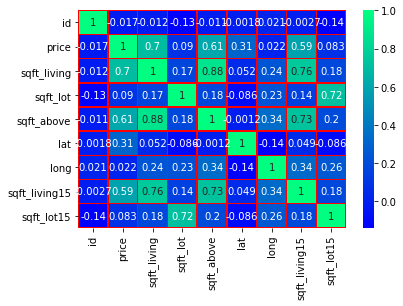

In [8]:
#this displays a heatmap of the continuous data only. I am only interested in looking at factors that have a high correlation 
#in the price column
display(sns.heatmap(data_continuous_only.corr(), annot=True, cmap="winter", linecolor='r',linewidth=0.5))

Summary of plot

- The highest correlation is (0.7), attributed to sqft living. This makes sense as price goes up so should your property size.
- The second is sqft above (.61), and through some googling we find that it is attributed to "all square feet above the ground, except your pool. https://cms.cws.net/content/semnrealtors.com/files/Finished%20Above%20Grade%20Square%20Feet.pdf
- The third is (.59) sqft living15. Which as per the column_names.md we know that it is the average size of the nearest 15 neighbor's houses. Which makes sense as some areas would be concentrated with houses priced higher than the mean because they are located together- investigating in zipcodes would be a nice start
- The major factors we also address are multicollinearity 
- I predict that sqft above and sqft living will be dependent on each other because their correlation score is 0.88.
- I also predict that sqft_living15 and sqft_living will be dependent on each other because their score is .59.
- I finally predict that sqft_lot and sqft_lot 15 are dependent on each other because their score is .72.

#### Part 1: Exploring the data to draw our hypothesis: Goal 2: Looking at our target variable

In [9]:
#price varaiables
print(data1.price.describe())
print("------------------------")
print(data1.price.isnull().sum())
print("------------------------")
data1.price

count     21597.00000
mean     540296.57351
std      367368.14010
min       78000.00000
25%      322000.00000
50%      450000.00000
75%      645000.00000
max     7700000.00000
Name: price, dtype: float64
------------------------
0
------------------------


0       221900.00000
1       538000.00000
2       180000.00000
3       604000.00000
4       510000.00000
            ...     
21592   360000.00000
21593   400000.00000
21594   402101.00000
21595   400000.00000
21596   325000.00000
Name: price, Length: 21597, dtype: float64

This shows me that there are potential problems because the max is almost 11 times the min.  There are outliers and we need to look at them and their attributes, however we cannot introduce bias to the data by simply filtering data based on price alone. We need to look at other variables and get rid of their outliers instead because in this way we are not modifying the data of interest directly.

In [10]:
#set up an IQR list to pass onto the data.price 
IQR = list(np.arange(0,1.0,0.05))

In [11]:
#we will see how this is after we are done and repeat the functions below
print(data1.price.quantile(IQR))


0.00000     78000.00000
0.05000    210000.00000
0.10000    245000.00000
0.15000    270000.00000
0.20000    298910.00000
0.25000    322000.00000
0.30000    345000.00000
0.35000    370000.00000
0.40000    399897.00000
0.45000    425000.00000
0.50000    450000.00000
0.55000    482000.00000
0.60000    519000.00000
0.65000    550000.00000
0.70000    595000.00000
0.75000    645000.00000
0.80000    700436.00000
0.85000    779722.00000
0.90000    887000.00000
0.95000   1160000.00000
Name: price, dtype: float64


In [12]:
#looking at our price mean and median 
price_mean = data1.price.mean()
print(price_mean)
price_median = data1.price.median()
print(price_median)

540296.5735055795
450000.0


the mean - median is: 90296.5735055795
--------------------------------
the IQR 


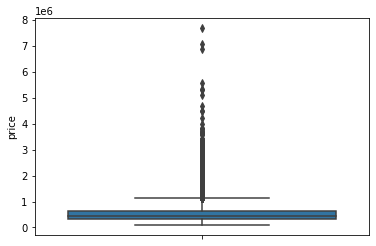

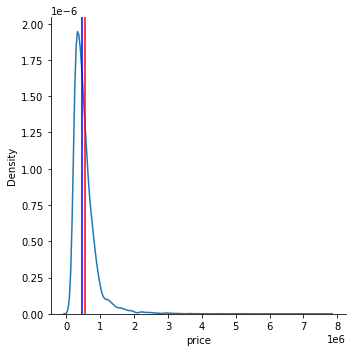

In [13]:
#Here we make a boxplot using seaborn so that we can see how the price is distributed through quantiles
#we also do a displot to see the kernel denesity estimate (aka price distribution.)
sns.boxplot(y = "price", data =data_continuous_only )
sns.displot(data_continuous_only, x="price", kind="kde")
plt.axvline(x=price_mean, color = "red")
plt.axvline(x=price_median, color = "blue")

#https://datavizpyr.com/how-to-add-a-mean-median-line-to-a-seaborn-displot/
#we can see that the medium is less than the mean but but how much?
print("the mean - median is:", (price_mean - price_median))
print("--------------------------------")
print("the IQR ")

So according to this plot, it is skewed to the right, the mean is greater than the median and there is heavy right tail. Which makes sense because most of our outliers lie to the right.
Graph on the top says the same thing!


13.048210941923953
13.017002861746503
the mean - median is: 0.031208080177449915
--------------------------------
the IQR 


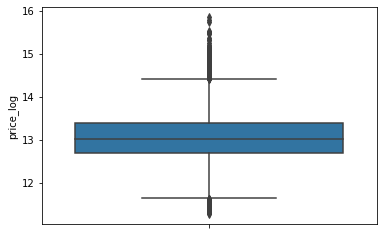

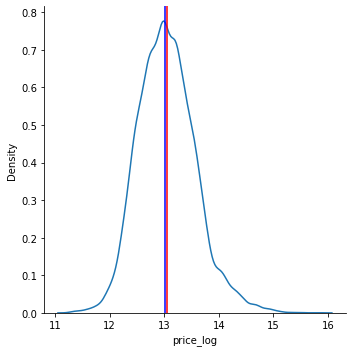

In [14]:
#Let's log it because might adjust normality

data1["price_log"] = np.log(data1["price"]) 
log_price_mean = data1.price_log.mean()
print(log_price_mean)
log_price_median = data1.price_log.median()
print(log_price_median)
sns.boxplot(y = "price_log", data =data1)
sns.displot(data1, x="price_log", kind="kde")
plt.axvline(x=log_price_mean, color = "red")
plt.axvline(x=log_price_median, color = "blue")

#https://datavizpyr.com/how-to-add-a-mean-median-line-to-a-seaborn-displot/
#we can see that the medium is less than the mean but but how much?
print("the mean - median is:", (log_price_mean - log_price_median))
print("--------------------------------")
print("the IQR ")


We log it because of this image
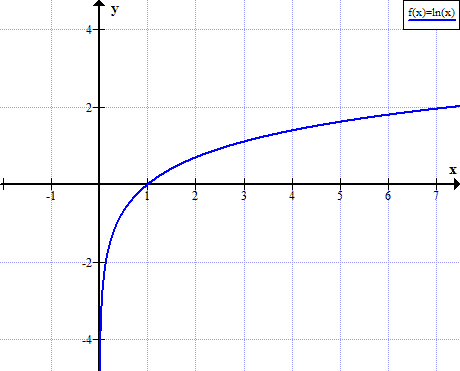
- This looks extraordinarily complicated but simply put, the graph is curving upwards towards a maximum value
- This is the same principle in which we "log" the target variable because there are heavier outliers closer to the maximum of our data. They are more "drawn in" towards larger values, compared to the rest of the data, which is why the previous graph showed such skewness!

Image origin: https://www.geogebra.org/m/vHZnWJ7b


### Why log, why overcomplicate yourself?
"Log is essential in modelling because it reduces skewness, we're using a natural logarithim to transform our target variable in order to evaluate the percentage change of our predictor values- some of these predictors may be log transformed as well. The question we have on from here is: How do we approach a model regression with [transformed] predictors using a transformed target variable?"

Expert & wise Guru advice 

Please see the full context in this website for further details.

https://stats.oarc.ucla.edu/other/mult-pkg/faq/general/faqhow-do-i-interpret-a-regression-model-when-some-variables-are-log-transformed/
____________________________

We are going to disect that and answer it.
My interpretation:
Let us assume that the final model is: Log price = sqft_living_log * 0.2+ grade * 0.2 + waterfront* 0.2


1 : For an one unit increase (an +1 in grade, with 1 being the lowest and 13 the highest) in grade (range: [1-13]), we should see (exp(.2)=1.22%) increase in price. This is for a nontransformed variable (log-level regression).

2 : Likewise, we can use the presence of waterfronts as another categorical feature OHE'd (log-level regression) and expect 1.22% increase in price if one is present, assuming all other variables are constant.

3 : Finally we look at squarefoot log: as long as the ratio between the two sqfoot values we are comparing stays the same (2000/100) or (200/10), we can expect the ratio of the price values to equal: (1+.2)^.2. Thus when there is a 20% increase in squarefoot values, we can expect a increase of ~3.7% in price (log-log regression).

### We will continue to explore this in the discussion portion
_____________

#### Part 1: Exploring the data to draw our hypothesis: Goal 3: Creating a visualization of the map with Lat/Long coordinates *Supplemental

This is a territory that includes seattle: lets set the zipcodes first and create a visualization

In [15]:
# We load in the folium package as outlined
import folium
import pandas as pd
import json
from folium import plugins
df=pd.read_csv("kc_house_data.csv")
#found the geojson file online: https://medium.com/@jade.adams517/using-geopandas-and-folium-to-build-maps-on-python-c51c5aad5f44
#courtsey of Jade Adams
with open("Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson") as f:
    kingscount = json.load(f)

In [16]:
#using a new data frame we convert to the proper long and lat 
df["longitude"]= df["long"]
df["latitude"]= df["lat"]

In [17]:
#set the midpoint, superimpose the dots onto the map
kingscountmap = folium.Map(location=[47.5480, -121.9836], tiles='Stamen Toner', zoom_start=9)
folium.GeoJson(kingscount).add_to(kingscountmap)

In [18]:
#create the map 
#credits to: https://towardsdatascience.com/making-3-easy-maps-with-python-fb7dfb1036
for i,row in df.iterrows():
    folium.CircleMarker((row.latitude,row.longitude), radius=3, weight=2, color='red', fill_color='red', fill_opacity=.5).add_to(kingscountmap)
kingscountmap.save("kingscountmap.html")
kingscountmap

So we can clearly see where there are clusters of neighborhoods and that waterfronts properties tend to lie more north and west

In [19]:
#now lets create a map that highlights the most popular areas
#credits to: https://towardsdatascience.com/making-3-easy-maps-with-python-fb7dfb1036
df["zip"] = df["zipcode"]
#count all the ids and store it as a series
numStoresSeries = df.groupby('zip').count().id
#create a base data frame
numStoresByZip = pd.DataFrame()
#if zipcode exist, store it as a string into the index of numStoresSeries, which is grouped by zipcode already 
numStoresByZip['zipcode'] = [str(i) for i in numStoresSeries.index]
#store zipcodes by price by creating an integer for each index. please see markdown for more details
numStoresByZip['price'] = numStoresSeries.values
#create the folium map
#kingscountmap = folium.Map(location=[47.5480, -121.9836], tiles='Stamen Toner', zoom_start=9)
#produces heatmap for all zipcodes and an integer, the higher the integer the more green it is- this can be useful.
#does not mean that price is connectected to zipcodes
#kingscountmap.choropleth(geo_data='Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson', data=numStoresByZip, columns=['zipcode', 'price'], \
                 #key_on='feature.properties.ZIPCODE', fill_color='YlGn', fill_opacity=1)
#save it 
kingscountmap.save("kingsChoropleth.html")
#kingscountmap

__________
"""

#store zipcodes by price by creating an integer for each index. please see markdown for more details

numStoresByZip['price'] = numStoresSeries.values

"""

what this ^ code means is that we are storing values (zipcode and their corresponding aount) as a seperate column called price
______________

#### Part 1: Exploring the data to draw our hypothesis: Goal 4: How do zipcodes influence the prices, more specifically, does living in seattle cause an increase in price of a house?

In [20]:
#This can tell you how "popular a zipcode is"
numStoresByZip


,zipcode,price
0,98001,361
1,98002,199
2,98003,280
3,98004,317
4,98005,168
...,...,...
65,98177,255
66,98178,262
67,98188,136
68,98198,280


In [21]:
#lets try a different approach, we are going to look at all the zipcodes and the avg price 

table = pd.pivot_table(data1, values = "price", index=["zipcode"],
                      aggfunc={"price": np.mean})
table = table.sort_values(
     by="price",
     ascending=False
 )
display(table)
print("----------")
display(table.tail(10))

,price
zipcode,
98039,2161300.00000
98004,1356523.99054
98040,1194873.63830
98112,1096239.00743
98102,899607.67308
...,...
98148,284908.59649
98001,281194.86981
98032,251296.24000


----------


,price
zipcode,
98031,300340.40293
98030,296187.98047
98003,294111.27857
98188,289078.34559
98023,286742.81162
98148,284908.59649
98001,281194.86981
98032,251296.24000
98168,240328.37175


While I feel like this can be useful I don't believe it's worth exploring. It would skew our data too much

In [22]:
#lets see if being in seattle causes an increase in price and start questioning our hypothesis
#list obtained from https://www.zipdatamaps.com/zipcodes-seattle-wa
seattle_zip_codes = [98101, 98102, 98103, 98104, 98105, 98106, 98107, 98108, 98109, 
              98110, 98111, 98112, 98114, 98115, 98116, 98117, 98118, 98119, 
              98121, 98122, 98124, 98125, 98126, 98129, 98131, 98132, 98133,
              98134, 98136, 98138, 98144, 98145, 98146, 98148, 98151, 98154,
              98155, 98158, 98160, 98161, 98164, 98166, 98168, 98170, 98171,
              98174, 98177, 98178, 98181, 98184, 98185, 98188, 98190, 98191,
              98195, 98198, 98199]


The code below is explained as follows, and its purpose is to find out if a zipcode is in seattle.: If we take each element (i) in the column zipcodes (to which we are applying our apply function and saying if it remains the same if it appears in seattle zipcodes and 0 if its anything else.)) Thus all values that are present can be identified as "seattle".

In [23]:
df["zipcode"] = df["zipcode"].apply(lambda i: i if i in seattle_zip_codes else 0)
print(df.zipcode)


0        98178
1        98125
2            0
3        98136
4            0
         ...  
21592    98103
21593    98146
21594    98144
21595        0
21596    98144
Name: zipcode, Length: 21597, dtype: int64


In [24]:
print("Remember the mean price was:" + data1.price.mean().astype(str))

#if we drop all the nonseattle zipcodes we can see that the difference in values is 
df.drop(df.index[df["zipcode"] == 0], inplace=True)
price_seattle_mean = df.price.mean()
print("the mean of every single property OUTSIDE OF SEATTLE sold is:" + (data1.price.mean().astype(str)))
print("the mean of every single property INSIDE SEATTLE sold is:" + (df.price.mean().astype(str)))
df

Remember the mean price was:540296.5735055795
the mean of every single property OUTSIDE OF SEATTLE sold is:540296.5735055795
the mean of every single property INSIDE SEATTLE sold is:535085.5999108437


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,longitude,latitude,zip
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,1955,0.00000,98178,47.51120,-122.25700,1340,5650,-122.25700,47.51120,98178
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,1951,1991.00000,98125,47.72100,-122.31900,1690,7639,-122.31900,47.72100,98125
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,1965,0.00000,98136,47.52080,-122.39300,1360,5000,-122.39300,47.52080,98136
7,2008000270,1/15/2015,291850.00000,3,1.50000,1060,9711,1.00000,NO,NaN,...,1963,0.00000,98198,47.40950,-122.31500,1650,9711,-122.31500,47.40950,98198
8,2414600126,4/15/2015,229500.00000,3,1.00000,1780,7470,1.00000,NO,NONE,...,1960,0.00000,98146,47.51230,-122.33700,1780,8113,-122.33700,47.51230,98146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21591,2997800021,2/19/2015,475000.00000,3,2.50000,1310,1294,2.00000,NO,NONE,...,2008,0.00000,98116,47.57730,-122.40900,1330,1265,-122.40900,47.57730,98116
21592,263000018,5/21/2014,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,2009,0.00000,98103,47.69930,-122.34600,1530,1509,-122.34600,47.69930,98103
21593,6600060120,2/23/2015,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,2014,0.00000,98146,47.51070,-122.36200,1830,7200,-122.36200,47.51070,98146
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,2009,0.00000,98144,47.59440,-122.29900,1020,2007,-122.29900,47.59440,98144


#### Part 1: Goal 4: How do zipcodes influence the prices, more specifically, does living in seattle cause an increase in price of a house? Living in seattle causes an decrease of 5k in the average price of home sold in this data set.
______________

#### Part 1: Goal 5: Does having a waterfront increase property value?

In [25]:
#reset 
df=pd.read_csv("kc_house_data.csv")

In [26]:
#have a basic understanding for the data. notice that our subsample size is 146
print(df["waterfront"].unique())
print(df.waterfront.value_counts())

[nan 'NO' 'YES']
NO     19075
YES      146
Name: waterfront, dtype: int64


In [27]:
#dropping
df = df.dropna(axis=0, subset=["waterfront"])
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,7 Average,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,6 Low Average,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
4,1954400510,2/18/2015,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,8 Good,1680,0.0,1987,0.00000,98074,47.61680,-122.04500,1800,7503
5,7237550310,5/12/2014,1230000.00000,4,4.50000,5420,101930,1.00000,NO,NONE,...,11 Excellent,3890,1530.0,2001,0.00000,98053,47.65610,-122.00500,4760,101930
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21591,2997800021,2/19/2015,475000.00000,3,2.50000,1310,1294,2.00000,NO,NONE,...,8 Good,1180,130.0,2008,0.00000,98116,47.57730,-122.40900,1330,1265
21592,263000018,5/21/2014,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,8 Good,1530,0.0,2009,0.00000,98103,47.69930,-122.34600,1530,1509
21593,6600060120,2/23/2015,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,8 Good,2310,0.0,2014,0.00000,98146,47.51070,-122.36200,1830,7200
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,7 Average,1020,0.0,2009,0.00000,98144,47.59440,-122.29900,1020,2007


In [28]:
#so if we drop all the waterfronts with the entry no we would be able to see the averages of those that do
df.drop(df.index[df["waterfront"] == "NO"], inplace=True)
print(df.price.mean())
print(data1.price.quantile(IQR))
df

1717214.7260273972
0.00000     78000.00000
0.05000    210000.00000
0.10000    245000.00000
0.15000    270000.00000
0.20000    298910.00000
0.25000    322000.00000
0.30000    345000.00000
0.35000    370000.00000
0.40000    399897.00000
0.45000    425000.00000
0.50000    450000.00000
0.55000    482000.00000
0.60000    519000.00000
0.65000    550000.00000
0.70000    595000.00000
0.75000    645000.00000
0.80000    700436.00000
0.85000    779722.00000
0.90000    887000.00000
0.95000   1160000.00000
Name: price, dtype: float64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
49,822039084,3/11/2015,1350000.00000,3,2.50000,2753,65005,1.00000,YES,AVERAGE,...,9 Better,2165,588.0,1953,0.00000,98070,47.40410,-122.45100,2680,72513
230,8096000060,4/13/2015,655000.00000,2,1.75000,1450,15798,2.00000,YES,EXCELLENT,...,7 Average,1230,220.0,1915,1978.00000,98166,47.44970,-122.37500,2030,13193
246,2025069065,9/29/2014,2400000.00000,4,2.50000,3650,8354,1.00000,YES,EXCELLENT,...,9 Better,1830,1820.0,2000,0.00000,98074,47.63380,-122.07200,3120,18841
264,2123039032,10/27/2014,369900.00000,1,0.75000,760,10079,1.00000,YES,EXCELLENT,...,5 Fair,760,0.0,1936,0.00000,98070,47.46830,-122.43800,1230,14267
300,3225069065,6/24/2014,3080000.00000,4,5.00000,4550,18641,1.00000,YES,EXCELLENT,...,10 Very Good,2600,1950.0,2002,0.00000,98074,47.60530,-122.07700,4550,19508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19968,2025069140,3/17/2015,1900000.00000,3,2.50000,2830,4334,3.00000,YES,EXCELLENT,...,10 Very Good,2830,0.0,2006,0.00000,98074,47.63180,-122.07100,2830,38211
20309,518500480,8/11/2014,3000000.00000,3,3.50000,4410,10756,2.00000,YES,EXCELLENT,...,11 Excellent,3430,980.0,2014,0.00000,98056,47.52830,-122.20500,3550,5634
20751,8043700105,4/17/2015,2300000.00000,4,4.00000,4360,8175,2.50000,YES,EXCELLENT,...,10 Very Good,3940,420.0,2007,0.00000,98008,47.57240,-122.10400,2670,8525
21185,518500460,10/8/2014,2230000.00000,3,3.50000,3760,5634,2.00000,YES,EXCELLENT,...,11 Excellent,2830,930.0,2014,0.00000,98056,47.52850,-122.20500,3560,5762


#### Part 1: Goal 5: Does having a waterfront increase property value?
Yes the average price of 146 homes with a waterfront goes up to 1,717,214 almost 350% of the original mean value.
______________________

#### Part 1: Goal 6: What are the effects of a "view" on the price of home?

In [29]:
#reset
df=pd.read_csv("kc_house_data.csv")
print(df["view"].unique())
print(df.view.value_counts())
NONE =        19422
AVERAGE =        957
GOOD  =         508
FAIR  =         330
EXCELLENT =     317
df

['NONE' nan 'GOOD' 'EXCELLENT' 'AVERAGE' 'FAIR']
NONE         19422
AVERAGE        957
GOOD           508
FAIR           330
EXCELLENT      317
Name: view, dtype: int64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,7 Average,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,7 Average,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,6 Low Average,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
4,1954400510,2/18/2015,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,8 Good,1680,0.0,1987,0.00000,98074,47.61680,-122.04500,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,8 Good,1530,0.0,2009,0.00000,98103,47.69930,-122.34600,1530,1509
21593,6600060120,2/23/2015,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,8 Good,2310,0.0,2014,0.00000,98146,47.51070,-122.36200,1830,7200
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,7 Average,1020,0.0,2009,0.00000,98144,47.59440,-122.29900,1020,2007
21595,291310100,1/16/2015,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,8 Good,1600,0.0,2004,0.00000,98027,47.53450,-122.06900,1410,1287


In [30]:
#lookinag at this we can drop all nan values 
df = df.dropna(axis=0, subset=["view"])

In [31]:
#lets just see if there is a distinguishment between none and a view
df.drop(df.index[df["view"] == "NONE"], inplace=True)
print(df.price.mean())
#if we drop all but none then we get 938700-

937800.3446969697


C:\Users\Gamer\anaconda3\envs\learn-env\lib\site-packages\pandas\core\frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [32]:
#what about average? what would that increase it to?
df.drop(df.index[df["view"] == "AVERAGE"], inplace=True)
print(df.price.mean())

1059111.4658008658


In [33]:
df.drop(df.index[df["view"] == "GOOD"], inplace=True)
print(df.price.mean())

1126499.0154559505


In [34]:
df.drop(df.index[df["view"] == "FAIR"], inplace=True)
print(df.price.mean())

1452465.883280757


In [35]:
df.drop(df.index[df["view"] == "EXCELLENT"], inplace=True)
print(df.price.mean())

nan


[92.3, 146.5, 150.5, 180.1, 268.8]


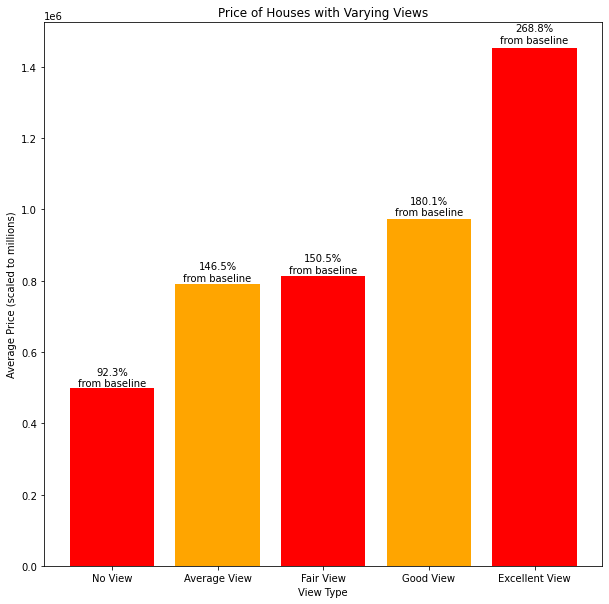

In [36]:
#After finding the rolling averages we determine that the avg mean matches the view below so thus we create a pd.dataframe
bar_graph_views = pd.DataFrame({"Amount": [498822, 791390, 813374, 973284, 1452465],
                               "Type" : ("No View", "Average View", "Fair View", "Good View", "Excellent View")
                               })

#create fx where we can see increase % from baseline
percentage = []
for i in range(bar_graph_views.shape[0]):
#for any element in this view starting from column row 0: NTS this will not work if its not numerical like if we had amount and type reversed 
    pct = (bar_graph_views.Amount[i] / 540296) * 100
#say that the pct is the result you get from every single element as you go down a column
    percentage.append(round(pct, 1))
print(percentage)

#set up a new column 
bar_graph_views['Percentage'] = percentage

plt.figure(figsize=(10, 10))
colors_list = ['Red', 'Orange', 'Red', 'Orange', 'Red']

#let graph = the fx of plotting a bar graph across 3 variables, type amount and color
graph = plt.bar(bar_graph_views.Type, bar_graph_views.Amount, color=colors_list)
plt.title('Price of Houses with Varying Views')

#iterate through each row
i = 0
#create the fx for every row and the neighbors across it, define the width and define the height then get the variables x,y which if we look above are the type and amount
for p in graph:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
#thank you:https://www.geeksforgeeks.org/display-percentage-above-bar-chart-in-matplotlib/
#this is telling us that in this fx, we want i (all row values in the index[i]) graphed, then move onto the next one.
    plt.text(x+width/2,
             y+height*1.01,
             str(bar_graph_views.Percentage[i])+'%'+"\n"+ "from baseline",
             ha='center',
             weight='medium')
    i += 1

plt.ylabel('Average Price (scaled to millions)')
plt.xlabel('View Type')
plt.show()


#### Part 1: Goal 6: What are the effects of a "view" on the price of home?
1) Remember that the total price is equal to the # of rows multipled by the average (21,597*540,296): $11,668,772,712  


2) The mean of all excellent views is 1452465. The quantity is 317. The total price of all excellent views was 460431405. The mean is $1,452,465  

3) The mean of all excellent views and fair views was 1,126,499. The quantity was 317 + 330. The total price of excellent and fair views was 728,844,853. Thus, total price of all the price of fair views was; 268,413,448. The mean of all "fair" houses is $ 813,374

4) The mean of all excellent, fair, and good views was 1,059,111. The quantity was 317+330+508. The total price of excellent, fair and good views was 1,223,273,205. The total price of "good views" was 494,428,352. The mean of all "good view houses" is $973,284 

5) The mean of all excellent, fair good and average was 937,800. The quantity was (317+330+508+957). The total price of excellent, fair, good and average was 1,980,633,600. The price of total price of all "average view houses" was 757,360,395. The mean of "average view houses" was $791,390.  

6) The mean of all excellent, fair, good, average and none was 540,296. The quantity was (21597). The total price was 11,668,772,712. The overall price of none was 9,688,139,112. The mean was $498,822

__________________________________________


#### Part 1: Goal 7: What are the effects of a "condition" on the price of home?

In [37]:
#reset 
df=pd.read_csv("kc_house_data.csv")
print(df["condition"].unique())
print(df.condition.value_counts())
df = df.dropna(axis=0, subset=["condition"])



['Average' 'Very Good' 'Good' 'Poor' 'Fair']
Average      14020
Good          5677
Very Good     1701
Fair           170
Poor            29
Name: condition, dtype: int64


In [38]:
df.drop(df.index[df["condition"] == "Poor"], inplace=True)
print(df.price.mean())
print(df.condition.value_counts())
df

540564.4541913946
Average      14020
Good          5677
Very Good     1701
Fair           170
Name: condition, dtype: int64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,7 Average,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,7 Average,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,6 Low Average,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
4,1954400510,2/18/2015,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,8 Good,1680,0.0,1987,0.00000,98074,47.61680,-122.04500,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,8 Good,1530,0.0,2009,0.00000,98103,47.69930,-122.34600,1530,1509
21593,6600060120,2/23/2015,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,8 Good,2310,0.0,2014,0.00000,98146,47.51070,-122.36200,1830,7200
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,7 Average,1020,0.0,2009,0.00000,98144,47.59440,-122.29900,1020,2007
21595,291310100,1/16/2015,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,8 Good,1600,0.0,2004,0.00000,98027,47.53450,-122.06900,1410,1287


In [39]:
df.drop(df.index[df["condition"] == "Fair"], inplace=True)
print(df.price.mean())
print(df.condition.value_counts())
df

542251.7879708384
Average      14020
Good          5677
Very Good     1701
Name: condition, dtype: int64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,7 Average,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,7 Average,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,6 Low Average,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
4,1954400510,2/18/2015,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,8 Good,1680,0.0,1987,0.00000,98074,47.61680,-122.04500,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,8 Good,1530,0.0,2009,0.00000,98103,47.69930,-122.34600,1530,1509
21593,6600060120,2/23/2015,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,8 Good,2310,0.0,2014,0.00000,98146,47.51070,-122.36200,1830,7200
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,7 Average,1020,0.0,2009,0.00000,98144,47.59440,-122.29900,1020,2007
21595,291310100,1/16/2015,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,8 Good,1600,0.0,2004,0.00000,98027,47.53450,-122.06900,1410,1287


In [40]:
df.drop(df.index[df["condition"] == "Average"], inplace=True)
print(df.price.mean())
print(df.condition.value_counts())
df

542401.3953645974
Good         5677
Very Good    1701
Name: condition, dtype: int64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
11,9212900260,5/27/2014,468000.00000,2,1.00000,1160,6000,1.00000,NO,NONE,...,7 Average,860,300.0,1942,0.00000,98115,47.69000,-122.29200,1330,6000
12,114101516,5/28/2014,310000.00000,3,1.00000,1430,19901,1.50000,NO,NONE,...,7 Average,1430,0.0,1927,nan,98028,47.75580,-122.22900,1780,12697
13,6054650070,10/7/2014,400000.00000,3,1.75000,1370,9680,1.00000,NO,NONE,...,7 Average,1370,0.0,1977,0.00000,98074,47.61270,-122.04500,1370,10208
17,6865200140,5/29/2014,485000.00000,4,1.00000,1600,4300,1.50000,NO,NONE,...,7 Average,1600,0.0,1916,0.00000,98103,47.66480,-122.34300,1610,4300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21063,3449000010,3/12/2015,294570.00000,3,1.00000,1140,8400,1.00000,NO,NONE,...,7 Average,1140,0.0,1960,0.00000,98059,47.50220,-122.14400,1400,9000
21196,7234600098,9/5/2014,552100.00000,3,3.00000,1330,1379,2.00000,NO,NONE,...,8 Good,1120,210.0,2005,nan,98122,47.61260,-122.31300,1810,1770
21287,522059130,4/29/2015,465000.00000,3,1.00000,1150,18200,1.00000,NO,NONE,...,7 Average,1150,0.0,1959,0.00000,98058,47.42620,-122.18700,1714,18200
21316,9266700190,5/11/2015,245000.00000,1,1.00000,390,2000,1.00000,NO,NONE,...,6 Low Average,390,0.0,1920,0.00000,98103,47.69380,-122.34700,1340,5100


In [41]:
df.drop(df.index[df["condition"] == "Good"], inplace=True)
print(df.price.mean())
print(df.condition.value_counts())
df

612577.7425044092
Very Good    1701
Name: condition, dtype: int64


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
3,2487200875,12/9/2014,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,7 Average,1050,910.0,1965,0.00000,98136,47.52080,-122.39300,1360,5000
25,1202000200,11/3/2014,233000.00000,3,2.00000,1710,4697,1.50000,NO,NONE,...,6 Low Average,1710,0.0,1941,0.00000,98002,47.30480,-122.21800,1030,4705
27,3303700376,12/1/2014,667000.00000,3,1.00000,1400,1581,1.50000,NO,NONE,...,8 Good,1400,0.0,1909,0.00000,98112,47.62210,-122.31400,1860,3861
49,822039084,3/11/2015,1350000.00000,3,2.50000,2753,65005,1.00000,YES,AVERAGE,...,9 Better,2165,588.0,1953,0.00000,98070,47.40410,-122.45100,2680,72513
62,5072410070,10/21/2014,505000.00000,3,1.75000,2519,8690,2.00000,NaN,NONE,...,8 Good,2519,0.0,1973,0.00000,98166,47.44280,-122.34400,2500,9500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19588,7518504130,6/26/2014,663000.00000,3,2.00000,1480,3876,1.00000,NO,NONE,...,7 Average,860,620.0,1928,nan,98117,47.68080,-122.38200,1660,3774
19604,3902100175,7/28/2014,850000.00000,5,3.00000,3900,5250,1.50000,NO,FAIR,...,8 Good,2620,1280.0,1931,0.00000,98116,47.55770,-122.38900,1950,5700
19857,3449000060,10/1/2014,320000.00000,3,1.00000,1400,9000,1.00000,NO,NONE,...,7 Average,1400,0.0,1959,0.00000,98059,47.50220,-122.14500,1440,8400
19889,2888000030,9/26/2014,500000.00000,4,2.25000,2270,8196,1.00000,NO,NONE,...,7 Average,1150,1120.0,1963,0.00000,98034,47.72140,-122.22700,1920,10122


[63.1, 60.7, 99.7, 98.1, 113.4]


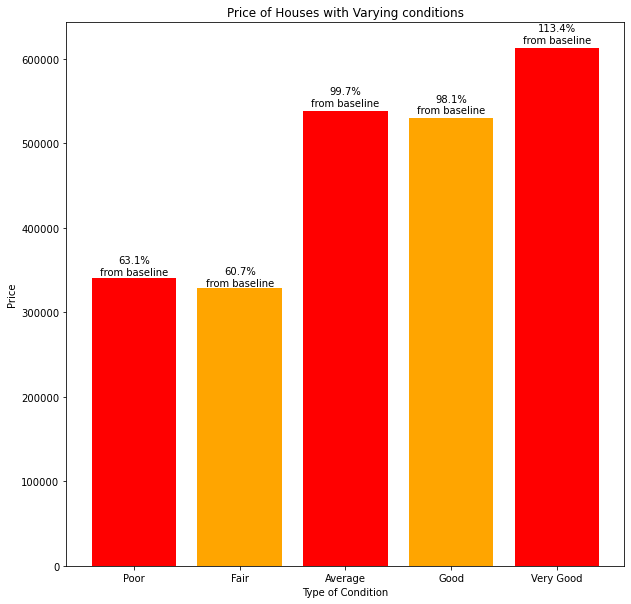

In [42]:
#After finding the rolling averages we determine that the avg mean matches the view below so thus we create a pd.dataframe
bar_graph_views2 = pd.DataFrame({"Amount": [340977, 328220,  538690, 529973, 612577],
                               "Type" : ("Poor", "Fair", "Average", "Good", "Very Good")
                               })

#create fx where we can see increase % from baseline
percentage2 = []
for i in range(bar_graph_views2.shape[0]):
#for any element in this view starting from column row 0: NTS this will not work if its not numerical like if we had amount and type reversed 
    pct2 = (bar_graph_views2.Amount[i] / 540296) * 100
#say that the pct is the result you get from every single element as you go down a column
    percentage2.append(round(pct2, 1))
print(percentage2)

#set up a new column 
bar_graph_views2['Percentage2'] = percentage2

plt.figure(figsize=(10, 10))
colors_list = ['Red', 'Orange', 'Red', 'Orange', 'Red']

#let graph = the fx of plotting a bar graph across 3 variables, type amount and color
graph2 = plt.bar(bar_graph_views2.Type, bar_graph_views2.Amount, color=colors_list)
plt.title('Price of Houses with Varying conditions')

#iterate through each row
i = 0
#create the fx for every row and the neighbors across it, define the width and define the height then get the variables x,y which if we look above are the type and amount
for p in graph2:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
#thank you:https://www.geeksforgeeks.org/display-percentage-above-bar-chart-in-matplotlib/
#this is telling us that in this fx, we want i (all row values in the index[i]) graphed, then move onto the next one.
    plt.text(x+width/2,
             y+height*1.01,
             str(bar_graph_views2.Percentage2[i])+'%'+"\n"+ "from baseline",
             ha='center',
             weight='medium')
    i += 1

plt.ylabel('Price')
plt.xlabel("Type of Condition")
plt.show()


#### Part 1 Goal 7

Condition:  
1) Remember that the total price is equal to the # of rows multipled by the average (21,597*540,296): $11,668,772,712  

2) The mean of "Very Good" conditions was $612,577(Average) thus multipled by the quanitity (1701) is 1041993477 and represents the cumulative sum of the "Very Good" conditions.

3) The average of Very Good and Good is 542401, multiplied by the total quantity  (1791+5677) we get 4050650668. Thus "Good" is 4050650668 – 1041993477 = 3008657191. The Average for very good is 3008657191/5677 = $529,973


4) Average and Very Good and Good (542251) x (14020+ 5677 + 1701) = 11603086898 – 4050650668 = sum of average houses = 7552436230. Average of an average house is $538,690.173324

5) Fair and Average and Very Good and Good = 540564 x (14020 + 5677 + 1701 + 170)= 11658884352. 11658884352 – 11603086898 = 55797454. Average of a fair house is $328,220.

6) Poor and Fair and Average and Very Good and Good = 540296 * (14020 + 5677 +1701+ 170 + 29) = 11668772712 – 11658884352 = 9888360/29 = $340,977
_____________

#### Part 1 Goal 8 What effect does grade have on the price of the home?

In [43]:
#reset 
df=pd.read_csv("kc_house_data.csv")
#IMDB_merge_genres_exploded = IMDB_BOM_TN_DRAFT.drop('genres', axis=1).join(IMDB_BOM_TN_DRAFT['genres'].str.split(',', expand=True).stack().reset_index(level=1, drop=True).rename('genres'))
df = df.drop("grade", axis=1).join(df.grade.str.split(" ", expand=True).stack().reset_index(level=1, drop=True).rename('grade'))
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,grade
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650,7
0,7129300520,10/13/2014,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,1180,0.0,1955,0.00000,98178,47.51120,-122.25700,1340,5650,Average
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639,7
1,6414100192,12/9/2014,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,2170,400.0,1951,1991.00000,98125,47.72100,-122.31900,1690,7639,Average
2,5631500400,2/25/2015,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,770,0.0,1933,nan,98028,47.73790,-122.23300,2720,8062,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21594,1523300141,6/23/2014,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,1020,0.0,2009,0.00000,98144,47.59440,-122.29900,1020,2007,Average
21595,291310100,1/16/2015,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,1600,0.0,2004,0.00000,98027,47.53450,-122.06900,1410,1287,8
21595,291310100,1/16/2015,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,1600,0.0,2004,0.00000,98027,47.53450,-122.06900,1410,1287,Good
21596,1523300157,10/15/2014,325000.00000,2,0.75000,1020,1076,2.00000,NO,NONE,...,1020,0.0,2008,0.00000,98144,47.59410,-122.29900,1020,1357,7


In [44]:
#made grade into a number
#https://stackoverflow.com/questions/52180879/how-to-keep-just-the-numbers-on-a-column-dataframe-that-also-has-strings
df = df[pd.to_numeric(df['grade'], errors='coerce').notnull()]
df.sort_values(by="grade", ascending=False)


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,grade
19724,3630240140,1/23/2015,585000.00000,4,3.00000,2110,1286,2.00000,NO,NONE,...,1710,400.0,2007,0.00000,98029,47.54440,-122.01400,2000,1286,9
7907,6352600490,1/14/2015,820000.00000,4,3.50000,2770,8049,2.00000,NO,NONE,...,2770,0.0,2002,0.00000,98074,47.64690,-122.08100,3410,7447,9
13921,4379400580,8/13/2014,698000.00000,3,2.50000,2580,4636,2.00000,NO,NONE,...,2580,0.0,2006,0.00000,98074,47.62010,-122.02500,2480,4500,9
10193,3530200160,6/3/2014,654950.00000,4,2.50000,2790,45902,2.00000,NO,NONE,...,2790,0.0,1987,0.00000,98077,47.76740,-122.08600,2890,42421,9
18480,7732410220,7/1/2014,808000.00000,4,2.25000,2500,8866,2.00000,NO,NONE,...,2500,0.0,1987,0.00000,98007,47.66040,-122.14600,2630,8847,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1245,9103000393,9/10/2014,1230000.00000,5,4.50000,3732,4426,2.50000,NO,NONE,...,2932,800.0,2001,0.00000,98112,47.61890,-122.28800,2950,4000,10
18679,424069206,1/12/2015,835000.00000,4,2.50000,2950,48351,2.00000,NO,NONE,...,2950,0.0,1986,0.00000,98075,47.59380,-122.04800,2870,34417,10
14039,7397300220,5/29/2014,2750000.00000,4,3.25000,4430,21000,2.00000,NO,NONE,...,4430,0.0,1952,2007.00000,98039,47.63980,-122.23700,3930,20000,10
3953,7525530100,9/8/2014,1020000.00000,5,3.50000,4180,17841,2.00000,NO,AVERAGE,...,3160,1020.0,1990,0.00000,98075,47.56180,-122.03700,3260,12608,10


AttributeError: 'list' object has no attribute 'set_xticklabels'

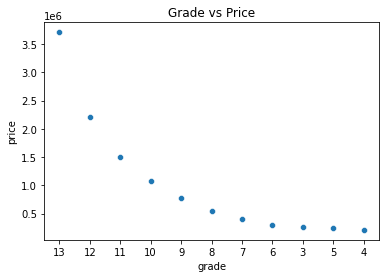

In [46]:
#ideally, the following would work but you dont have the value counts and cannot pass a function unlike the variables we've done so far
table = None

table = pd.pivot_table(df, values = "price", index=["grade"],
                      aggfunc={"price": np.mean})
table = table.sort_values(
     by="price",
     ascending=False
 )
ax = sns.scatterplot(x="grade", y="price", data=table).set(title="Grade vs Price")
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30)
print(table.value_counts())
table

#### Part 1 Goal 8 What effect does grade have on the price of the home?

What this graph shows us is that as you go down in grade, there is a substantial drop in in price, the grade 8 is where the mean lies.
__________________________

#### Part 1 Goal 9: What effect does time have on prices of houses sold? Is selling a seasonal thing?

In [47]:
#reset 
df=pd.read_csv("kc_house_data.csv")
#convert to dt
df["date"] = pd.to_datetime(df["date"])
#find min max range
print(data1["date"].min())
print(data1["date"].max())


1/10/2015
9/9/2014


In [48]:
#convert fully into month, date, year each having their own seperate column
df["date"].dt.to_period("M")
df['date'].dt.strftime('%m/%Y')
df['yyyy'] = pd.to_datetime(df['date']).dt.year
df['mm'] = pd.to_datetime(df['date']).dt.month
df['d'] = pd.to_datetime(df['date']).dt.day
df['yyyy'].astype(str) + '-'+ df['mm'].astype(str)
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yyyy,mm,d
0,7129300520,2014-10-13,221900.00000,3,1.00000,1180,5650,1.00000,NaN,NONE,...,1955,0.00000,98178,47.51120,-122.25700,1340,5650,2014,10,13
1,6414100192,2014-12-09,538000.00000,3,2.25000,2570,7242,2.00000,NO,NONE,...,1951,1991.00000,98125,47.72100,-122.31900,1690,7639,2014,12,9
2,5631500400,2015-02-25,180000.00000,2,1.00000,770,10000,1.00000,NO,NONE,...,1933,nan,98028,47.73790,-122.23300,2720,8062,2015,2,25
3,2487200875,2014-12-09,604000.00000,4,3.00000,1960,5000,1.00000,NO,NONE,...,1965,0.00000,98136,47.52080,-122.39300,1360,5000,2014,12,9
4,1954400510,2015-02-18,510000.00000,3,2.00000,1680,8080,1.00000,NO,NONE,...,1987,0.00000,98074,47.61680,-122.04500,1800,7503,2015,2,18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,2014-05-21,360000.00000,3,2.50000,1530,1131,3.00000,NO,NONE,...,2009,0.00000,98103,47.69930,-122.34600,1530,1509,2014,5,21
21593,6600060120,2015-02-23,400000.00000,4,2.50000,2310,5813,2.00000,NO,NONE,...,2014,0.00000,98146,47.51070,-122.36200,1830,7200,2015,2,23
21594,1523300141,2014-06-23,402101.00000,2,0.75000,1020,1350,2.00000,NO,NONE,...,2009,0.00000,98144,47.59440,-122.29900,1020,2007,2014,6,23
21595,291310100,2015-01-16,400000.00000,3,2.50000,1600,2388,2.00000,NaN,NONE,...,2004,0.00000,98027,47.53450,-122.06900,1410,1287,2015,1,16


<AxesSubplot:xlabel='mm', ylabel='price'>

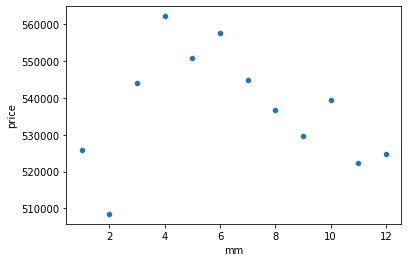

In [49]:
#create a table where we pivot it based off of month in our index
table = None

table = pd.pivot_table(df, values = "price", index=["mm"],
                      aggfunc={"price": np.mean})
table = table.sort_values(
     by="price",
     ascending=False
 )
sns.scatterplot(x="mm", y="price", data=table)

What we know from google is that the first fiscal quarter of a year ends on march 31st, and there seems to be the highest price in april. 

<AxesSubplot:xlabel='d', ylabel='price'>

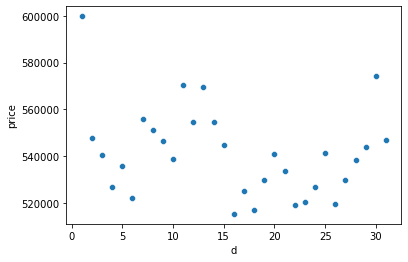

In [50]:
#create a table where we pivot it based off of day in our index
table = None

table = pd.pivot_table(df, values = "price", index=["d"],
                      aggfunc={"price": np.mean})
table = table.sort_values(
     by="price",
     ascending=False
 )
sns.scatterplot(x="d", y="price", data=table)

This graph is a little bit more complicated because we see some trends if we evaluate it from the beginning of the month to the end. but if we try to look at it from intervals we see that at the beginnning to the middle of the month prices go down. when we see in the middle to the end of the month, each week increases. This is just a speculation, I will not include this in my data 

<AxesSubplot:xlabel='yyyy', ylabel='price'>

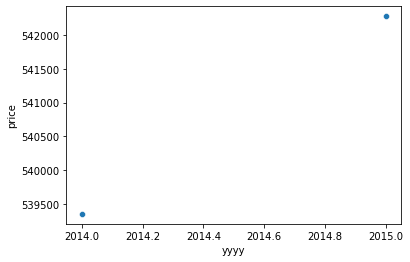

In [51]:
#create a table where we pivot it based off of year
table = None

table = pd.pivot_table(df, values = "price", index=["yyyy"],
                      aggfunc={"price": np.mean})
table = table.sort_values(
     by="price",
     ascending=False
 )
sns.scatterplot(x="yyyy", y="price", data=table)

#### Part 1 Goal 9 What effect does time have on the price of the home?
As much as we want to correlation this as a stastically significant event (price change due to year) there are too many factors and opposing trends as evident in our previous graph. 
_________________

#### Part 1 Goal 10: Does the presence of a basement affect the price?

In [52]:
#reset
df=pd.read_csv("kc_house_data.csv")
#find all the unique values
print(df["sqft_basement"].unique())
print(df.sqft_basement.value_counts())
#getting rid of nan
df.dropna(axis=0, subset=["sqft_basement"])
#unlike the previous ones we can just take away the ? and the 0.0 values as they both suggest a lack of a basement in the house sold.
#getting rid of "?"
#getting rid of any 0s
df.drop(df.index[df["sqft_basement"] == "?"], inplace=True)
df.drop(df.index[df["sqft_basement"] == "0.0"], inplace=True)



['0.0' '400.0' '910.0' '1530.0' '?' '730.0' '1700.0' '300.0' '970.0'
 '760.0' '720.0' '700.0' '820.0' '780.0' '790.0' '330.0' '1620.0' '360.0'
 '588.0' '1510.0' '410.0' '990.0' '600.0' '560.0' '550.0' '1000.0'
 '1600.0' '500.0' '1040.0' '880.0' '1010.0' '240.0' '265.0' '290.0'
 '800.0' '540.0' '710.0' '840.0' '380.0' '770.0' '480.0' '570.0' '1490.0'
 '620.0' '1250.0' '1270.0' '120.0' '650.0' '180.0' '1130.0' '450.0'
 '1640.0' '1460.0' '1020.0' '1030.0' '750.0' '640.0' '1070.0' '490.0'
 '1310.0' '630.0' '2000.0' '390.0' '430.0' '850.0' '210.0' '1430.0'
 '1950.0' '440.0' '220.0' '1160.0' '860.0' '580.0' '2060.0' '1820.0'
 '1180.0' '200.0' '1150.0' '1200.0' '680.0' '530.0' '1450.0' '1170.0'
 '1080.0' '960.0' '280.0' '870.0' '1100.0' '460.0' '1400.0' '660.0'
 '1220.0' '900.0' '420.0' '1580.0' '1380.0' '475.0' '690.0' '270.0'
 '350.0' '935.0' '1370.0' '980.0' '1470.0' '160.0' '950.0' '50.0' '740.0'
 '1780.0' '1900.0' '340.0' '470.0' '370.0' '140.0' '1760.0' '130.0'
 '520.0' '890.0' '1110.0'

In [53]:
print(df["sqft_basement"].unique())
print(df.sqft_basement.value_counts())

['400.0' '910.0' '1530.0' '730.0' '1700.0' '300.0' '970.0' '760.0' '720.0'
 '700.0' '820.0' '780.0' '790.0' '330.0' '1620.0' '360.0' '588.0' '1510.0'
 '410.0' '990.0' '600.0' '560.0' '550.0' '1000.0' '1600.0' '500.0'
 '1040.0' '880.0' '1010.0' '240.0' '265.0' '290.0' '800.0' '540.0' '710.0'
 '840.0' '380.0' '770.0' '480.0' '570.0' '1490.0' '620.0' '1250.0'
 '1270.0' '120.0' '650.0' '180.0' '1130.0' '450.0' '1640.0' '1460.0'
 '1020.0' '1030.0' '750.0' '640.0' '1070.0' '490.0' '1310.0' '630.0'
 '2000.0' '390.0' '430.0' '850.0' '210.0' '1430.0' '1950.0' '440.0'
 '220.0' '1160.0' '860.0' '580.0' '2060.0' '1820.0' '1180.0' '200.0'
 '1150.0' '1200.0' '680.0' '530.0' '1450.0' '1170.0' '1080.0' '960.0'
 '280.0' '870.0' '1100.0' '460.0' '1400.0' '660.0' '1220.0' '900.0'
 '420.0' '1580.0' '1380.0' '475.0' '690.0' '270.0' '350.0' '935.0'
 '1370.0' '980.0' '1470.0' '160.0' '950.0' '50.0' '740.0' '1780.0'
 '1900.0' '340.0' '470.0' '370.0' '140.0' '1760.0' '130.0' '520.0' '890.0'
 '1110.0' '150.0' '

In [54]:
df.price.mean()

623046.8774798606

#### Part 1 Goal 10: Does the presence of a basement affect the price?
As we can see, having a basement of any size will increase the price by almost $100,000
__________________________________

### Part 1 Recap
1) (I) There is no substantial difference between inside or outside seattle. P1G4

2) (E) Having a waterfront increases the property price by about 300% P1G5

3) (E) Views have an impact on the price of the home P1G6

4) (I) Conditions have no impact on the price of the home unless its rated poor or fair, which is about a 40% decrease from the mean. P1G7

5) (E) Grades are appear to impact the mean price of the house significant thus we can assume that it may be a good predictor. P1G8

6) (E) Timing of the house sold will not be used in our predictions P1G9

7) (I) Basements increase the mean price by $100,000 P1G10

Based on the evidence my hypothesis is that Categorical External variables will have a stronger influence than categorical internal variables on the price. The null hypothesis is that it does not have an influence on the price.

____________
### Part 2: Data Cleaning, Goal 1: Analysis of other variables
Now we move onto the next step, which is analyzing the spread of the variables and considering their impact on our predictor variable (price)

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000,17755.00000,21597.00000,21597.00000,21597.00000,21597.00000,21597.00000
mean,4580474287.77099,540296.57351,3.37320,2.11583,2080.32185,15099.40876,1.49410,1788.59684,1970.99968,83.63678,98077.95185,47.56009,-122.21398,1986.62032,12758.28351
std,2876735715.74778,367368.14010,0.92630,0.76898,918.10613,41412.63688,0.53968,827.75976,29.37523,399.94641,53.51307,0.13855,0.14072,685.23047,27274.44195
min,1000102.00000,78000.00000,1.00000,0.50000,370.00000,520.00000,1.00000,370.00000,1900.00000,0.00000,98001.00000,47.15590,-122.51900,399.00000,651.00000
25%,2123049175.00000,322000.00000,3.00000,1.75000,1430.00000,5040.00000,1.00000,1190.00000,1951.00000,0.00000,98033.00000,47.47110,-122.32800,1490.00000,5100.00000
50%,3904930410.00000,450000.00000,3.00000,2.25000,1910.00000,7618.00000,1.50000,1560.00000,1975.00000,0.00000,98065.00000,47.57180,-122.23100,1840.00000,7620.00000
75%,7308900490.00000,645000.00000,4.00000,2.50000,2550.00000,10685.00000,2.00000,2210.00000,1997.00000,0.00000,98118.00000,47.67800,-122.12500,2360.00000,10083.00000
max,9900000190.00000,7700000.00000,33.00000,8.00000,13540.00000,1651359.00000,3.50000,9410.00000,2015.00000,2015.00000,98199.00000,47.77760,-121.31500,6210.00000,871200.00000


-----------------


<AxesSubplot:>

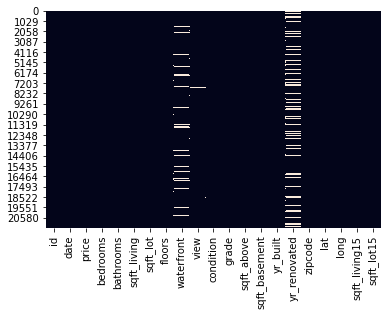

In [55]:
#Based on the information provided in part 1, it is now acceptable to look at other variables 
#reset
data1 = pd.read_csv("kc_house_data.csv")
display(data1.describe())
print("-----------------")
#find all null values in a heat map
sns.heatmap(data1.isnull(), cbar=False)

We might want to reconsider our evaluation of having a waterfront or expect a low coefficient due to lack of data

In [56]:
#double checking our variables of interest 
print(data1.sqft_living.isna().sum())
print(data1.sqft_lot.isna().sum())
print(data1.sqft_above.isna().sum())
print(data1.sqft_living15.isna().sum())
print(data1.sqft_lot15.isna().sum())

0
0
0
0
0


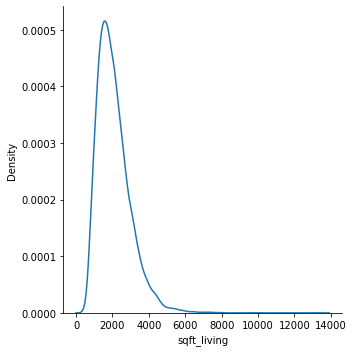

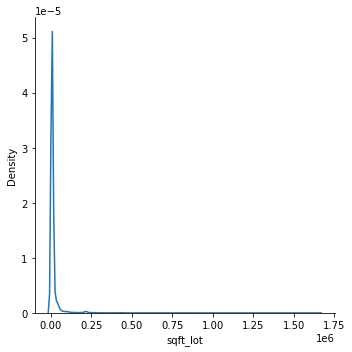

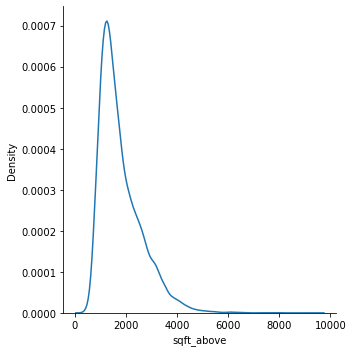

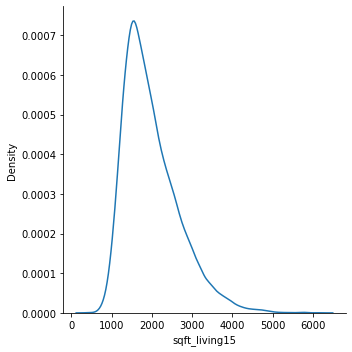

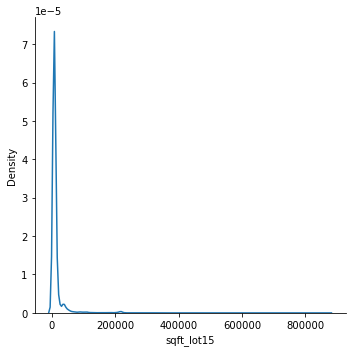

In [57]:
#triple checking for possible skewness
sns.displot(data1, x="sqft_living", kind="kde")
sns.displot(data1, x="sqft_lot", kind="kde")
sns.displot(data1, x="sqft_above", kind="kde")
sns.displot(data1, x="sqft_living15", kind="kde")
sns.displot(data1, x="sqft_lot15", kind="kde")

As we can see these functions are all right skewed, thus if we take the logs they should be more representative of a normal distrubition- this will be done later. 

Data Cleaning so that it is representative across all 5 different preliminary models

In [58]:
#using variables not to be included into our analysis as our basis to drop certain prices, reduces bias 
#lets look at bedrooms and bathrooms 
display(data1.bedrooms.value_counts())
print("-------------------------")
display(data1.bathrooms.value_counts())

3     9824
4     6882
2     2760
5     1601
6      272
1      196
7       38
8       13
9        6
10       3
11       1
33       1
Name: bedrooms, dtype: int64

-------------------------


2.50000    5377
1.00000    3851
1.75000    3048
2.25000    2047
2.00000    1930
1.50000    1445
2.75000    1185
3.00000     753
3.50000     731
3.25000     589
3.75000     155
4.00000     136
4.50000     100
4.25000      79
0.75000      71
4.75000      23
5.00000      21
5.25000      13
5.50000      10
1.25000       9
6.00000       6
5.75000       4
0.50000       4
8.00000       2
6.25000       2
6.75000       2
6.50000       2
7.50000       1
7.75000       1
Name: bathrooms, dtype: int64

In [59]:
#we're going to drop some extremities 
data1.drop(data1.index[data1["bathrooms"] >= 5], inplace=True)
data1.bathrooms.value_counts()
print(data1.price.mean())

535211.4938930944


In [60]:
#we're going to drop some extremities 
data1.drop(data1.index[data1["bedrooms"] >= 8], inplace=True)
print(data1.price.mean())

534820.7641426114


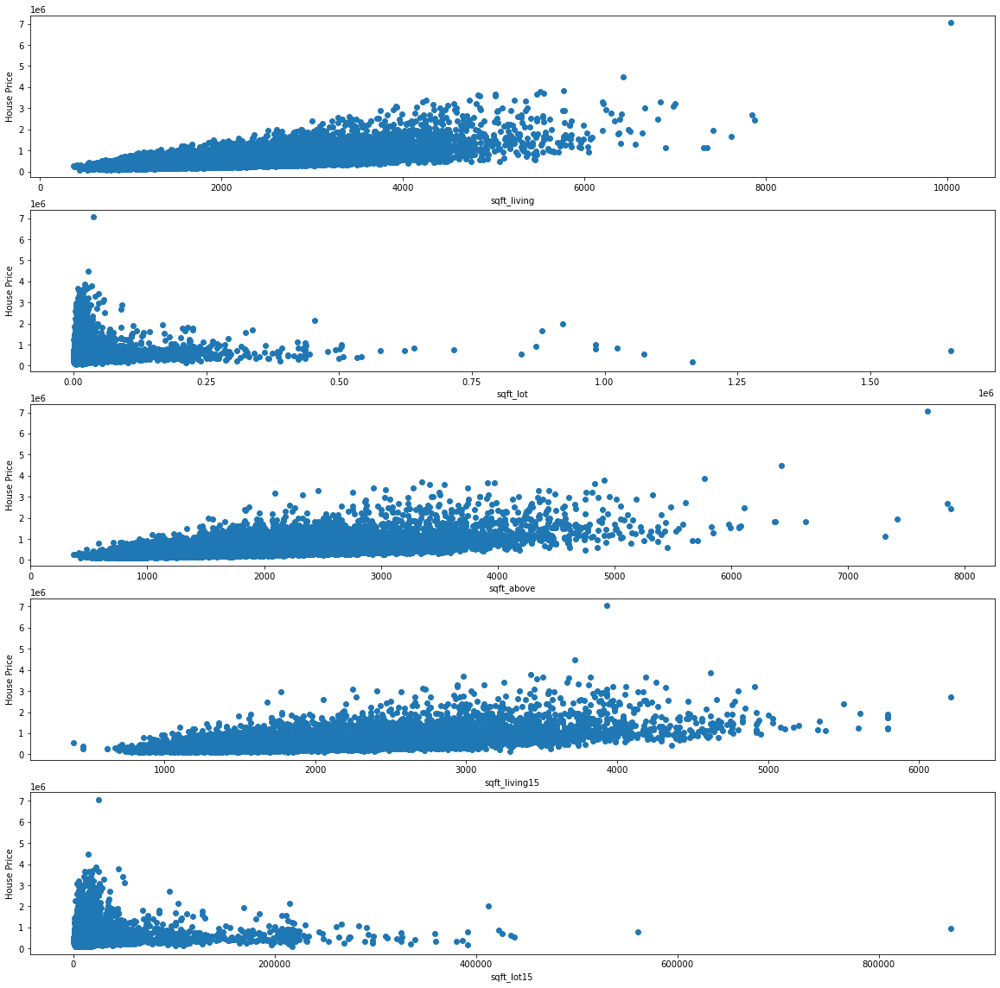

In [61]:
#lets create the scatter plots for the general continuous variables we will be using

fig, ax = plt.subplots(5, figsize=(20,20))
ax[0].scatter(x= data1["sqft_living"], y=  data1["price"])
ax[0].set_xlabel("sqft_living")
ax[0].set_ylabel("House Price")
ax[1].scatter(x= data1["sqft_lot"], y=  data1["price"])
ax[1].set_xlabel("sqft_lot")
ax[1].set_ylabel("House Price")
ax[2].scatter(x= data1["sqft_above"], y=  data1["price"])
ax[2].set_xlabel("sqft_above")
ax[2].set_ylabel("House Price")
ax[3].scatter(x= data1["sqft_living15"], y=  data1["price"])
ax[3].set_xlabel("sqft_living15")
ax[3].set_ylabel("House Price")
ax[4].scatter(x= data1["sqft_lot15"], y=  data1["price"])
ax[4].set_xlabel("sqft_lot15")
ax[4].set_ylabel("House Price")

plt.show()

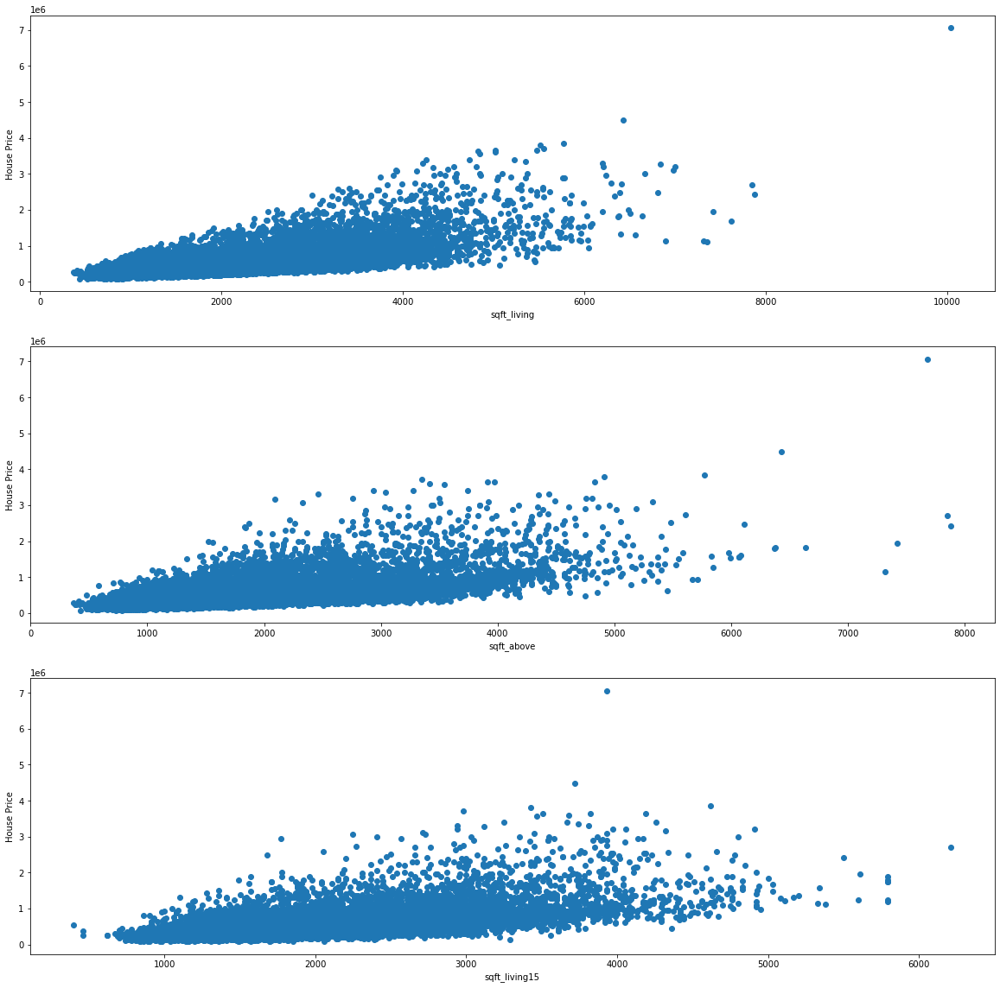

In [62]:
#we will chooose 0,2,3 as they show the most positive correlations with 1,4 poor correlation as they represent themselves now
fig, ax = plt.subplots(3, figsize=(20,20))
ax[0].scatter(x= data1["sqft_living"], y=  data1["price"])
ax[0].set_xlabel("sqft_living")
ax[0].set_ylabel("House Price")

ax[1].scatter(x= data1["sqft_above"], y=  data1["price"])
ax[1].set_xlabel("sqft_above")
ax[1].set_ylabel("House Price")
ax[2].scatter(x= data1["sqft_living15"], y=  data1["price"])
ax[2].set_xlabel("sqft_living15")
ax[2].set_ylabel("House Price")

plt.show()

### Part 3 Modelling: Goal 1: Finding the best R^2 model with different combinations of continuous variables and verifying with VIF 

In [63]:
#a high VIF means that there is strong multicollinearity betwen variables and we want it less than or at 3.
#we import add_constant because we know we anticipate a price for the house just based on the property it was sold
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
#need vif for multicoll check
#need constant 

So we start off the model with the three highest correlations to price

In [64]:
Y = data1["price"]
X = data1[["sqft_living15", "sqft_living", "sqft_above"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("_____________________________")
#copied from lab but it basically means for all X values and an i variable. for every i in the range (of the shape of the first second column)
# we want to use the variance_inflation_factor function across the different variables 
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#we see high vif values, we are going to investigate each of these individually

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.486
Model:                            OLS   Adj. R-squared:                  0.486
Method:                 Least Squares   F-statistic:                     6790.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:            -2.9760e+05
No. Observations:               21513   AIC:                         5.952e+05
Df Residuals:                   21509   BIC:                         5.952e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const         -8.209e+04   5191.784    -15.811

High multicollinearity is present due to the VIF values. we will examine the three independently and select our model based off the highest R^value with appropriate p values

In [65]:
#exploring R^2
Y = data1["price"]
X = data1[["sqft_above"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("_____________________________")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#no

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.348
Model:                            OLS   Adj. R-squared:                  0.348
Method:                 Least Squares   F-statistic:                 1.149e+04
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:            -3.0017e+05
No. Observations:               21513   AIC:                         6.003e+05
Df Residuals:                   21511   BIC:                         6.004e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       8.744e+04   4583.090     19.078      0.0

In [66]:

X = None 
Y = data1["price"]
X = data1[["sqft_living15"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("_____________________________")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#not using this r is too low

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.351
Model:                            OLS   Adj. R-squared:                  0.351
Method:                 Least Squares   F-statistic:                 1.163e+04
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:            -3.0012e+05
No. Observations:               21513   AIC:                         6.002e+05
Df Residuals:                   21511   BIC:                         6.003e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const         -5.955e+04   5826.420    -10.221

In [67]:
X = None 
Y = data1["price"]
X = data1[["sqft_living"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("_____________________________")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#using

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.473
Model:                            OLS   Adj. R-squared:                  0.473
Method:                 Least Squares   F-statistic:                 1.934e+04
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:            -2.9787e+05
No. Observations:               21513   AIC:                         5.958e+05
Df Residuals:                   21511   BIC:                         5.958e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const       -1.779e+04   4322.851     -4.115      

#### Part 3 Modelling: Goal 1: Finding the best R^2 model with different combinations of continuous variables and verifying with VIF  
We are going off on squarefootliving as our first variable due to the highest r^2 from our three initial models.
______________

#### Part 3 Modeling: Goal 2: Find the Best R^2 model with log functions to address skews in the data

We repeat P3G1 experiments except we introduce a few log transformed variables this time to help reduce skewness and find more interactions that can be measured using such transformations

In [68]:
#theres a lot of assumutions when interpreting coefficients so bear with me
data1["price_log"] = np.log(data1["price"]) 
data1["sqft_living15_log"] = np.log(data1["sqft_living15"]) 
data1["sqft_living_log"] = np.log(data1["sqft_living15"]) 
data1["sqft_above_log"] = np.log(data1["sqft_above"]) 

In [69]:
# put none so that you can go through different models if you haven't noticed 
X= None
Y= None 
Y = data1["price_log"]
X = data1[["sqft_living15_log", "sqft_living_log", "sqft_above_log"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())
print("_____________________________")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#this can be seen that some of the intiai variables do not need to be logged

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.409
Model:                            OLS   Adj. R-squared:                  0.409
Method:                 Least Squares   F-statistic:                     7450.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:                -10816.
No. Observations:               21513   AIC:                         2.164e+04
Df Residuals:                   21510   BIC:                         2.166e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 5.6233      0.06

C:\Users\Gamer\anaconda3\envs\learn-env\lib\site-packages\statsmodels\stats\outliers_influence.py:193: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


The important take away from this is that the formula: 
VIF = 1/1-R^2

implies that 1-R^2 (R^2:correlation between the variables) is 1 (when VIF shows to be this inf) which indicates perfect collinearity

In [70]:
#so since the price has transformed, we can play around with our original 3 variables and see which transformation can improve our r^2 value
X= None
Y= None 
Y = data1["price_log"]
X = data1[["sqft_living", "sqft_living15"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif
#r^2 increased, i like

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.494
Model:                            OLS   Adj. R-squared:                  0.494
Method:                 Least Squares   F-statistic:                 1.051e+04
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:                -9145.6
No. Observations:               21513   AIC:                         1.830e+04
Df Residuals:                   21510   BIC:                         1.832e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const            12.0791      0.008   1548.938

[9.546882135475109, 2.382375138573429, 2.382375138573429]

In [71]:
#so since the price has transformed, we can play around with our original 3 variables and see which transformation can improve our r^2 value
X= None
Y= None 
Y = data1["price_log"]
X = data1[["sqft_living", "sqft_above"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif
#no

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.475
Model:                            OLS   Adj. R-squared:                  0.475
Method:                 Least Squares   F-statistic:                     9746.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:                -9538.5
No. Observations:               21513   AIC:                         1.908e+04
Df Residuals:                   21510   BIC:                         1.911e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const          12.2092      0.007   1852.191      

[6.57660426472916, 4.155281373463257, 4.155281373463257]

I've deleted the other models but you can confirm for yourself that their R^2 values were lower
We are going to go with the model that does well after transformation

____________
#### Part 3 Modeling: Goal 2: Find the Best R^2 model with log functions to address skews in the data
 Y = price_log

 X = sqft_living, sqft_living15 
 _______________

#### Part 3 Modelling: Goal 3: Use transformed variables 

In [72]:
#transform the sqft_lot15 of the nearest neighbhors to demonstrate how "isolated" a house is
data1["sqft_lot15_new"]= (data1['sqft_lot15'] * 15)


In [73]:
#ideally we can use this function to find the mean of the sqft15"new" and take the top 50% percentile and classify it as "rural"
#and bottom 50%th as "urban"
#instead we're just going to take the log of it
data1["sqft_lot15_new_log"] = np.log(data1["sqft_lot15_new"]) 

In [74]:
#subtract so that we can see what a baseline of 0 does and make it easier to analyze our results.
data1["lat"] = (data1["lat"] -47)
data1["long"] = (data1["long"] + 122.519)

In [75]:
data1.long

0       0.26200
1       0.20000
2       0.28600
3       0.12600
4       0.47400
          ...  
21592   0.17300
21593   0.15700
21594   0.22000
21595   0.45000
21596   0.22000
Name: long, Length: 21513, dtype: float64

In [76]:
#find the correlation
data1.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,...,lat,long,sqft_living15,sqft_lot15,price_log,sqft_living15_log,sqft_living_log,sqft_above_log,sqft_lot15_new,sqft_lot15_new_log
id,1.00000,-0.01619,0.00263,0.00817,-0.00975,-0.13171,0.01874,-0.00861,0.02298,-0.01222,...,-0.00151,0.02158,-0.00133,-0.14045,-0.00202,-0.00218,-0.00218,0.00012,-0.14045,-0.14689
price,-0.01619,1.00000,0.31156,0.50523,0.68803,0.08339,0.26233,0.59003,0.04972,0.12874,...,0.32225,0.02158,0.59237,0.07734,0.90824,0.55404,0.55404,0.54212,0.07734,0.14059
bedrooms,0.00263,0.31156,1.00000,0.52059,0.59508,0.03068,0.17997,0.49069,0.16684,0.01433,...,-0.01550,0.14152,0.40717,0.02896,0.34492,0.42184,0.42184,0.52965,0.02896,0.16822
bathrooms,0.00817,0.50523,0.52059,1.00000,0.74308,0.07572,0.50916,0.67182,0.51747,0.04619,...,0.02218,0.22854,0.56745,0.07652,0.53996,0.57294,0.57294,0.69040,0.07652,0.07963
sqft_living,-0.00975,0.68803,0.59508,0.74308,1.00000,0.16266,0.35630,0.87140,0.32401,0.05029,...,0.05025,0.24647,0.76174,0.17666,0.68922,0.74020,0.74020,0.84618,0.17666,0.31727
sqft_lot,-0.13171,0.08339,0.03068,0.07572,0.16266,1.00000,-0.00812,0.17318,0.04999,0.00528,...,-0.08819,0.22816,0.14383,0.71068,0.09380,0.14505,0.14505,0.15721,0.71068,0.54906
floors,0.01874,0.26233,0.17997,0.50916,0.35630,-0.00812,1.00000,0.52847,0.49109,0.00259,...,0.04857,0.12596,0.27917,-0.01468,0.30898,0.27412,0.27412,0.54766,-0.01468,-0.23130
sqft_above,-0.00861,0.59003,0.49069,0.67182,0.87140,0.17318,0.52847,1.00000,0.42942,0.01806,...,-0.00442,0.35040,0.73354,0.18695,0.59122,0.70501,0.70501,0.96589,0.18695,0.30678
yr_built,0.02298,0.04972,0.16684,0.51747,0.32401,0.04999,0.49109,0.42942,1.00000,-0.22423,...,-0.14850,0.40922,0.32629,0.06879,0.07757,0.33336,0.33336,0.45255,0.06879,0.01511
yr_renovated,-0.01222,0.12874,0.01433,0.04619,0.05029,0.00528,0.00259,0.01806,-0.22423,1.00000,...,0.03163,-0.07138,-0.00164,0.00492,0.11613,-0.00508,-0.00508,0.02219,0.00492,0.01887


A great view to see that multicollinearity exists (between bedrooms, bathrooms, sqft_above):sqft_living

In [77]:
#lets see if the new variable can improve our model
X= None
Y= None 
Y = data1["price_log"]
X = data1[["sqft_living", "sqft_living15", "sqft_lot15_new"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.496
Model:                            OLS   Adj. R-squared:                  0.496
Method:                 Least Squares   F-statistic:                     7066.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:                -9100.0
No. Observations:               21513   AIC:                         1.821e+04
Df Residuals:                   21509   BIC:                         1.824e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const             12.0773      0.008   1551.

[9.55263882941972, 2.389682547757468, 2.3977922586897487, 1.0388949463229165]

In [78]:
#We see a little improvement, what about the log version
X= None
Y= None 
Y = data1["price_log"]
X = data1[["sqft_living", "sqft_living15", "sqft_lot15_new_log"]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.514
Model:                            OLS   Adj. R-squared:                  0.514
Method:                 Least Squares   F-statistic:                     7582.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:42   Log-Likelihood:                -8716.6
No. Observations:               21513   AIC:                         1.744e+04
Df Residuals:                   21509   BIC:                         1.747e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 13.1297      0

[215.60938331749773,
 2.3895415253918575,
 2.4969604577256512,
 1.1654085654921236]

We are now going to go with the model: 
Y = price_log
X = "sqft_living", "sqft_living15", "sqft_lot15_new_log"
_________________________________________

#### Part 3 Modelling: Goal 4: Use OHE

In [79]:
#setting up if theres a basement present
print(data1.sqft_basement.value_counts())
basement_dummy = [0.0]



0.0       12803
?           451
600.0       214
500.0       209
700.0       208
          ...  
792.0         1
1770.0        1
1281.0        1
1852.0        1
508.0         1
Name: sqft_basement, Length: 293, dtype: int64


In [80]:
#same execution a couple of lines up
data1.drop(data1.index[data1["sqft_basement"] == "?"], inplace=True)
print(data1.sqft_basement.value_counts())
#changing to float
data1["sqft_basement"] = pd.to_numeric(data1["sqft_basement"],errors = 'coerce')
data1.sqft_basement

0.0       12803
600.0       214
500.0       209
700.0       208
800.0       201
          ...  
861.0         1
143.0         1
2010.0        1
2350.0        1
274.0         1
Name: sqft_basement, Length: 292, dtype: int64


0         0.00000
1       400.00000
2         0.00000
3       910.00000
4         0.00000
           ...   
21592     0.00000
21593     0.00000
21594     0.00000
21595     0.00000
21596     0.00000
Name: sqft_basement, Length: 21062, dtype: float64

In [81]:
#fx to tell us if theres a basement while creating a new variable: if x = 0 then make a column called BASEMENT? and return 0 for that house
#this means theres no basement.
#a 1 indicates that there is a basement 
def basement(x):
    if x in basement_dummy:
        return 0
    else:
        return 1
data1["BASEMENT?"] = data1["sqft_basement"].apply(basement)


In [82]:
#checking to see if code worked
data1["BASEMENT?"].value_counts()

0    12803
1     8259
Name: BASEMENT?, dtype: int64

In [83]:
#setting up for category-ing our variables before they get dummied
#categorize the data

data1.condition.dropna()
data1.condition.value_counts()
data1.grade= data1.grade.astype("category")
data1.condition= data1.condition.astype("category")
data1.view= data1.view.astype("category")
data1.waterfront= data1.waterfront.astype("category")
data1["BASEMENT?"]=data1["BASEMENT?"].astype("category")

In [84]:
#dummying the variables 
categoricals = ["condition", "view", "waterfront", "grade","BASEMENT?"]
dummies=pd.get_dummies(data1[categoricals], prefix=categoricals, drop_first=True)
preprocessed_data1 = data1.drop(categoricals, axis=1)
preprocessed_data1 = pd.concat([preprocessed_data1, dummies], axis=1)
preprocessed_data1.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,...,grade_12 Luxury,grade_13 Mansion,grade_3 Poor,grade_4 Low,grade_5 Fair,grade_6 Low Average,grade_7 Average,grade_8 Good,grade_9 Better,BASEMENT?_1
count,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,...,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000,21062.00000
mean,4582406590.34935,535146.81944,3.36084,2.10494,2067.93116,14949.43144,1.49212,1779.31531,288.61585,1970.98671,...,0.00332,0.00028,0.00005,0.00128,0.01116,0.09482,0.41639,0.28136,0.12126,0.39213
std,2876236343.74267,344893.96495,0.88086,0.74448,885.57869,40597.33150,0.53900,807.36111,435.51460,29.30466,...,0.05756,0.01688,0.00689,0.03578,0.10504,0.29297,0.49297,0.44967,0.32644,0.48824
min,1000102.00000,78000.00000,1.00000,0.50000,370.00000,520.00000,1.00000,370.00000,0.00000,1900.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
25%,2123212130.25000,321000.00000,3.00000,1.75000,1420.00000,5040.00000,1.00000,1190.00000,0.00000,1952.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
50%,3904970470.00000,450000.00000,3.00000,2.25000,1910.00000,7620.00000,1.50000,1560.00000,0.00000,1975.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
75%,7312200100.00000,640000.00000,4.00000,2.50000,2540.00000,10639.75000,2.00000,2200.00000,560.00000,1997.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,1.00000,1.00000,0.00000,1.00000
max,9900000190.00000,7060000.00000,7.00000,4.75000,10040.00000,1651359.00000,3.50000,7880.00000,3500.00000,2015.00000,...,1.00000,1.00000,1.00000,1.00000,1.00000,1.00000,1.00000,1.00000,1.00000,1.00000


In [85]:
#creating a list of variables included so i can just delete them to increase the model's performance
column_names_PPdata = list(preprocessed_data1.columns.values)
column_names_PPdata

['id',
 'date',
 'price',
 'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'sqft_above',
 'sqft_basement',
 'yr_built',
 'yr_renovated',
 'zipcode',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15',
 'price_log',
 'sqft_living15_log',
 'sqft_living_log',
 'sqft_above_log',
 'sqft_lot15_new',
 'sqft_lot15_new_log',
 'condition_Fair',
 'condition_Good',
 'condition_Poor',
 'condition_Very Good',
 'view_EXCELLENT',
 'view_FAIR',
 'view_GOOD',
 'view_NONE',
 'waterfront_YES',
 'grade_11 Excellent',
 'grade_12 Luxury',
 'grade_13 Mansion',
 'grade_3 Poor',
 'grade_4 Low',
 'grade_5 Fair',
 'grade_6 Low Average',
 'grade_7 Average',
 'grade_8 Good',
 'grade_9 Better',
 'BASEMENT?_1']

In [86]:
X= None
Y= None 
Y = preprocessed_data1["price"]
X = preprocessed_data1[["sqft_living", "sqft_living15", "sqft_lot15_new_log",'condition_Fair',
 'condition_Good',
 'condition_Poor',
 'condition_Very Good',
 'view_EXCELLENT',
 'view_FAIR',
 'view_GOOD',
 'view_NONE',
 'waterfront_YES',
   'grade_11 Excellent',
 'grade_12 Luxury',
 'grade_13 Mansion',
 'grade_3 Poor',
 'grade_4 Low',
 'grade_5 Fair',
 'grade_6 Low Average',
 'grade_7 Average',
 'grade_8 Good',
 'grade_9 Better',    
  'BASEMENT?_1'                   ]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.637
Model:                            OLS   Adj. R-squared:                  0.637
Method:                 Least Squares   F-statistic:                     1605.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:43   Log-Likelihood:            -2.8777e+05
No. Observations:               21062   AIC:                         5.756e+05
Df Residuals:                   21038   BIC:                         5.758e+05
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                1.099e+06   2

[297.810759758795,
 3.527326750587741,
 2.9395914518878166,
 1.2806550562728563,
 1.02590500653938,
 1.1158906060198168,
 1.0179790324398375,
 1.0731217939810835,
 1.7551129656390638,
 1.3125642992394042,
 1.4713415067080475,
 2.110388137576516,
 1.4798703615084576,
 1.3585539535990727,
 1.0904192836042528,
 1.0124536050615731,
 1.0031275445278212,
 1.065015958102323,
 1.492208658870564,
 4.408204524965424,
 8.66798054988045,
 6.037799305891681,
 3.0759751080207134,
 1.1942654817685654]

This looks good but because of high VIF's and P values we're going to have to get rid of some variables. 

In [87]:
#Great this model is great, what happens if we log our results, will our vifs stay similar and our R^2 increase?
X= None
Y= None 
Y = preprocessed_data1["price_log"]
X = preprocessed_data1[["sqft_living", "sqft_living15", "sqft_lot15_new_log",'condition_Fair',
 'condition_Good',
 'condition_Poor',
 'condition_Very Good',
 'view_EXCELLENT',
 'view_FAIR',
 'view_GOOD',
 'view_NONE',
 'waterfront_YES',
   'grade_11 Excellent',
 'grade_12 Luxury',
 'grade_13 Mansion',
 'grade_3 Poor',
 'grade_4 Low',
 'grade_5 Fair',
 'grade_6 Low Average',
 'grade_7 Average',
 'grade_8 Good',
 'grade_9 Better',    
        'BASEMENT?_1',               "lat", "long" ]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.746
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     2478.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:44   Log-Likelihood:                -1690.6
No. Observations:               21062   AIC:                             3433.
Df Residuals:                   21036   BIC:                             3640.
Df Model:                          25                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  12.4470    

[353.346669832456,
 3.5551759519214086,
 3.0326716407310426,
 1.41250886022197,
 1.0265171984316217,
 1.123564537381638,
 1.018606768203534,
 1.0783715587362792,
 1.7563483010351473,
 1.3145565336134046,
 1.472906128825391,
 2.1264453001311363,
 1.4812807703044586,
 1.3608733481217823,
 1.091906480140116,
 1.013094559340568,
 1.0037900951470256,
 1.0668471121992547,
 1.50367865285137,
 4.445881274779881,
 8.759566385567279,
 6.093837494439854,
 3.084970706985788,
 1.2776359736631377,
 1.0758160781312898,
 1.4038795502236392]

As latitude increases, the temperature falls. Perhaps according as we go north, there are factors that influence the price increase that come with living more north. For instance the neighborhoods that are high in price maybe clustered towards the north. There can be an increase in views, the housing may be more durable and cost more due to the harsh winter conditions as you go more north.

In [88]:
#eliminating certain variables due to the high p value, high VIF and retaining others. more on this model in the summary
X= None
Y= None 
Y = preprocessed_data1["price_log"]
X = preprocessed_data1[["sqft_living", "sqft_living15", "sqft_lot15_new_log",'condition_Fair',
 'condition_Good',
 'condition_Poor',
 'condition_Very Good',
 'view_EXCELLENT',

 'view_GOOD',
 'view_NONE',
 'waterfront_YES',
   'grade_11 Excellent',
 'grade_12 Luxury',
 'grade_13 Mansion',

 'grade_4 Low',
 'grade_5 Fair',


 'grade_9 Better',    
                       "lat", "long" ]]
X = sm.add_constant(X)

model = sm.OLS(Y, X).fit()
print(model.summary())

print("-------------")
vif = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif
#a high JB score means that there is uneven error distribution

                            OLS Regression Results                            
Dep. Variable:              price_log   R-squared:                       0.717
Model:                            OLS   Adj. R-squared:                  0.717
Method:                 Least Squares   F-statistic:                     2807.
Date:                Sun, 19 Jun 2022   Prob (F-statistic):               0.00
Time:                        18:59:44   Log-Likelihood:                -2844.6
No. Observations:               21062   AIC:                             5729.
Df Residuals:                   21042   BIC:                             5888.
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  12.0122    

[292.56289725648173,
 2.656044754326178,
 2.7645609127806754,
 1.3671657045552104,
 1.0213810693655712,
 1.1012993001959215,
 1.01659346202272,
 1.0603505678130374,
 1.6808873991791966,
 1.3507995286592342,
 1.6370080380012144,
 1.480620702495132,
 1.2112992339555695,
 1.0677180233668422,
 1.010296477282655,
 1.0098415202358177,
 1.0422983722174242,
 1.2274507050074073,
 1.0549813981114795,
 1.3320608890507497]

None of my Tscores are low: 
Excerpt from https://www.statology.org/t-test-linear-regression/
If the p-value that corresponds to t is less than some threshold (e.g. α = .05) then we reject the null hypothesis and conclude that there is a statistically significant relationship between the predictor variable and the response variable.

# This is our final model with a R^2 of 71.7% of variance explained with just 20 variables. Let's save it.

In [89]:
#saving as pickle
import pickle
from sklearn import model_selection
from sklearn.linear_model import LogisticRegression

In [90]:
#saving as pickle
filename="final_model.sav"
pickle.dump(model, open(filename, 'wb'))

### Part 4. Analysis of Results

A lot of outliers outside the 95th percentile (At 1.64 it reaches the 95th percentle or SD 2+)

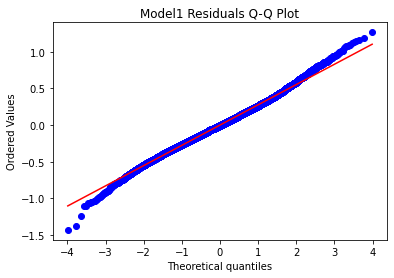

In [91]:
#so now we take a look at the residuals and the QQ plot
import scipy.stats as stats
stats.probplot(model.resid, dist="norm", plot= plt)
plt.title("Model1 Residuals Q-Q Plot")

#Saving plot as a png
plt.savefig("Model1_Resid_qqplot.png")


So looking at this plot we see that the ordered values are in ascending order.
Excerpt taken from https://dodona.ugent.be/nl/activities/1859394339/ 

Their interpretation: The theoretical quantiles are simply standard deviations. For this chart in particular The inverse function Φ − 1 ( x ) gives us the theoretical quantiles for the normal distribution. So, for example, Φ − 1 ( 0.975 ) = 1.96

My interpretation of their interpretation: My plot looks fine. Between 0 and +/-1.94 (values for theoretical quantiles) most of my data hasnt deviated yet. The only reason why the two tails appear to fall off is because I chose to include outliers in my data. The more expensive the actual price, the less the theoretical price will be. Vice versa, the cheaper the house the more the theoretical price will be.

In [92]:
import statsmodels.formula.api as smf
import statsmodels.stats.api as sms
from scipy import stats
from statsmodels.compat import lzip
import statsmodels
import matplotlib.pyplot as plt

In [93]:
#running to see the normality on the model
name = ['Jarque-Bera', 'Chi^2 two-tail prob.', 'Skew', 'Kurtosis']
test = sms.jarque_bera(model.resid)
lzip(name, test)

[('Jarque-Bera', 358.11130138030086),
 ('Chi^2 two-tail prob.', 1.726310657423207e-78),
 ('Skew', 0.11346487985644522),
 ('Kurtosis', 3.5971333005905235)]

So we see that the JB is high, which is fine because we know our data has outliers. The skew is almost 0 and the kurtosis is at 3.6. This means our data is again not as normally distributed as we want, but its fine because outliers

In [94]:
#check for homoscedasticity: the variance of residual is the same for any value of X
name = ['Lagrange multiplier statistic', 'p-value', 
        'f-value', 'f p-value']
test = sms.het_breuschpagan(model.resid, model.model.exog)
lzip(name, test)

[('Lagrange multiplier statistic', 1066.9914453836047),
 ('p-value', 2.610437830646901e-214),
 ('f-value', 59.09799657311354),
 ('f p-value', 3.6769268145455614e-220)]

According to this: https://medium.com/@remycanario17/tests-for-heteroskedasticity-in-python-208a0fdb04ab 
Since the p value of this is less than .05 we can assume heteroscedasticity, or homoscedastic if its flawed. In my opinion we need to find a graph where we can create a line to distinguish the two options. My prediction is on flawed homscedatic due to the outliers I chose to include.

### Part 5: Method Validation with Linear Regression 

In [95]:
#using the same features..
best_features = ["sqft_living", "sqft_living15", "sqft_lot15_new_log",'condition_Fair',
 'condition_Good',
 'condition_Poor',
 'condition_Very Good',
 'view_EXCELLENT',

 'view_GOOD',
 'view_NONE',
 'waterfront_YES',
   'grade_11 Excellent',
 'grade_12 Luxury',
 'grade_13 Mansion',

 'grade_4 Low',
 'grade_5 Fair',


 'grade_9 Better',    
                       "lat", "long" ]

In [96]:
preprocessed_data1[best_features].corr()

,sqft_living,sqft_living15,sqft_lot15_new_log,condition_Fair,condition_Good,condition_Poor,condition_Very Good,view_EXCELLENT,view_GOOD,view_NONE,waterfront_YES,grade_11 Excellent,grade_12 Luxury,grade_13 Mansion,grade_4 Low,grade_5 Fair,grade_9 Better,lat,long
sqft_living,1.00000,0.76144,0.31720,-0.06532,-0.08566,-0.03648,-0.01684,0.15109,0.15541,-0.25978,0.09614,0.34205,0.19059,0.07470,-0.05612,-0.13019,0.33490,0.05103,0.24599
sqft_living15,0.76144,1.00000,0.37293,-0.05281,-0.07533,-0.00939,-0.06088,0.14680,0.15601,-0.26511,0.08060,0.30634,0.17072,0.04007,-0.02617,-0.09407,0.34442,0.04992,0.33530
sqft_lot15_new_log,0.31720,0.37293,1.00000,0.02635,0.12563,0.00185,-0.00087,0.07086,0.06602,-0.10296,0.07961,0.12116,0.07786,0.01489,0.01148,0.02151,0.09378,-0.14266,0.37644
condition_Fair,-0.06532,-0.05281,0.02635,1.00000,-0.05329,-0.00325,-0.02609,-0.01071,-0.00659,0.02065,-0.00053,-0.01195,-0.00515,-0.00150,0.05683,0.06721,-0.02982,-0.02448,-0.01652
condition_Good,-0.08566,-0.07533,0.12563,-0.05329,1.00000,-0.02182,-0.17501,0.01637,0.01396,-0.02386,0.01196,-0.03598,-0.01393,-0.01009,0.00870,0.02064,-0.08078,-0.05800,-0.05869
condition_Poor,-0.03648,-0.00939,0.00185,-0.00325,-0.02182,1.00000,-0.01068,0.01761,-0.00562,-0.00094,0.01326,-0.00489,-0.00211,-0.00062,0.03511,0.10777,-0.01355,0.00470,-0.01521
condition_Very Good,-0.01684,-0.06088,-0.00087,-0.02609,-0.17501,-0.01068,1.00000,0.02724,0.00526,-0.03453,0.01356,-0.02454,-0.01078,-0.00494,-0.01049,0.02591,-0.04291,0.02526,-0.08452
view_EXCELLENT,0.15109,0.14680,0.07086,-0.01071,0.01637,0.01761,0.02724,1.00000,-0.01851,-0.36169,0.56348,0.08731,0.08356,0.02171,-0.00431,0.00249,0.04127,0.01247,-0.04341
view_GOOD,0.15541,0.15601,0.06602,-0.00659,0.01396,-0.00562,0.00526,-0.01851,1.00000,-0.46340,0.04250,0.07519,0.03497,-0.00260,-0.00552,-0.01335,0.06557,-0.01295,-0.03603
view_NONE,-0.25978,-0.26511,-0.10296,0.02065,-0.02386,-0.00094,-0.03453,-0.36169,-0.46340,1.00000,-0.24346,-0.13127,-0.08004,-0.02259,-0.00139,0.01567,-0.09523,-0.00573,0.08890


In [97]:
#set up the variables for LinRegr
x = None
y = None
x = preprocessed_data1[best_features]
y = preprocessed_data1.price_log

In [98]:
#StandardScaler is used to resize the distribution of price: the mean is 0 and the standard deviation is 1. There is no change
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X = sc.fit_transform(x)

In [99]:
#so randomstate = 0 means how "shuffled" the data is
#test size =.25 means that 25% of the data labled "preprocessed" (same as our model) is "hidden away" and becomes validated
#75% of the data gets trained
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,random_state = 0,test_size=0.25)

In [100]:
#ideal imports 
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
#https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html
#the following code comes for scikit's example to fit a linear model on data with the training set, default value for y intercept is true
regr = linear_model.LinearRegression().fit(X_train,y_train)
#make y_pred = to predicting the x trained variables 
y_pred = regr.predict(X_train)

In [101]:
#Let's find r^2 as per FlatIron's Cumulative Lab 20.
print("R squared: {}".format(r2_score(y_true=y_train,y_pred=y_pred)))

R squared: 0.7190270872331244


R^2 value is extremely close to our model

In [102]:
#this mean of residuals is suppose to be 0
residuals = y_train.values-y_pred
mean_residuals = np.mean(residuals)
print("Mean of Residuals {}".format(mean_residuals))

Mean of Residuals 1.539411798844646e-15


In [103]:
#let's find the length of the array
print(y_pred)
print(y_pred.shape)

[13.02492431 13.34961399 12.77193656 ... 12.96527232 12.55969794
 13.85211695]
(15796,)


In [104]:
#take the train values and rename it
y_aktual = y_train.values
y_aktual

array([13.11231304, 13.19932442, 12.8967167 , ..., 12.76568843,
       12.5776362 , 14.07015278])

In [105]:
#do some math
residualssquared = np.square(residuals, where = True )
residualssquared

#thank you https://appdividend.com/2022/02/17/np-square/#:~:text=The%20np.,of%20the%20source%20array%20elements.

array([0.00763679, 0.02258695, 0.01557008, ..., 0.03983373, 0.00032178,
       0.04753962])

In [106]:
#sum the residuals 
summed = np.sum(residualssquared)
#divide by rows -1 so find the shape first
unsquared_RMSE= summed/(15796-1)
RMSE = np.sqrt(unsquared_RMSE)
RMSE

0.2757654391639218

So when we consider the RMSE value we know that it is based off the log priced value which we remember is: 

In [107]:
#code this real quick
preprocessed_data1max = preprocessed_data1.price_log.max()
preprocessed_data1min = preprocessed_data1.price_log.min()
#then we find the max and min 
print(preprocessed_data1max)
print(preprocessed_data1min)

15.769955609469426
11.26446410567173


If we look at the impact of RMSE values .27 is extremely low in terms of the size of the error distance from predicted vs trained values

C:\Users\Gamer\anaconda3\envs\learn-env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\Gamer\anaconda3\envs\learn-env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


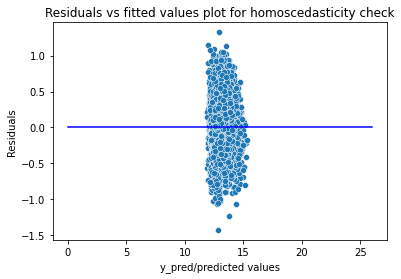

In [108]:
#homoscedasticity check
p = sns.scatterplot(y_pred,residuals)
plt.xlabel('y_pred/predicted values')
plt.ylabel('Residuals')



p = sns.lineplot([0,26],[0,0],color='blue')
p = plt.title('Residuals vs fitted values plot for homoscedasticity check')

Proves that our model is homoscedastic because theres the residuals are scattered across and not polarized, i.e the errors are random.

In [109]:
#Let's check for heteroscadisity on the trained model.
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
name = ['F statistic', 'p-value']
test = sms.het_goldfeldquandt(residuals, X_train)
lzip(name, test)
#https://www.statology.org/goldfeld-quandt-test-in-r/

[('F statistic', 1.0121912038491503), ('p-value', 0.295365130681999)]

The Goldfeld-Quandt test is used to determine if heteroscedasticity is present in a regression model.


The Goldfeld-Quandt test uses the following null and alternative hypotheses:

Null (H0): Homoscedasticity is present.
Alternative (HA): Heteroscedasticity is present.
Since the p-value is not less than 0.05, we fail to reject the null hypothesis. 
#### We do not have sufficient evidence to say that heteroscedasticity is present in the regression model.



Reprhased from Statistics by Jim @ https://statisticsbyjim.com/regression/heteroscedasticity-regression/

C:\Users\Gamer\anaconda3\envs\learn-env\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


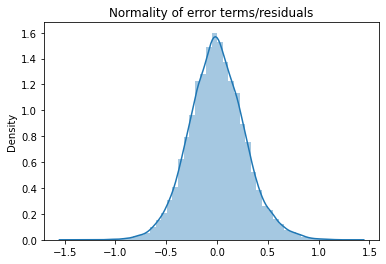

In [110]:
p = sns.distplot(residuals,kde=True)

p = plt.title('Normality of error terms/residuals')

In [111]:
#just double checking =)
data1 = pd.read_csv("kc_house_data.csv")

duplicate = data1[data1.duplicated()]
duplicate

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15


________________________________

## Conclusion (coefficients only):
_____________________________________

Since price is logged and some of the constants are not heres how model interpretation goes:

If the constant is not logged: then its log-level regression, where if we change the logged coefficient by 1%, we would expect our price to change by 100*(1%)

"If the coefficient is logged then its log-log regression; if we change x(dependent variable) by 1%, we'd expect to see a rise in the price by the coefficient in terms of x percentage change. 


1) const                 -77.5095      

2) sqft_living             0.0003   

3) sqft_living15           0.0002   


4) sqft_lot15_new_log     -0.0463     


5) condition_Fair         -0.1277   


6) condition_Good          0.0727      


7) condition_Poor         -0.2133     

8) condition_Very Good     0.1550     

9) view_EXCELLENT          0.1521    

10) view_GOOD               0.0671


11) view_NONE              -0.1581


12) waterfront_YES          0.4153


13) grade_11 Excellent      0.1565


14) grade_12 Luxury         0.1819


15) grade_13 Mansion        0.2394


16) grade_4 Low            -0.2650


17) grade_5 Fair           -0.2090


18) grade_9 Better          0.1290


______

## Regression results and conclusion

In [112]:
#using the data above we first seperate the coefficients based on external versus internal
Internal_reg = .0003 + .1277 + .0727 + .2133 + .1550
External_reg = .0002 + .1521 +.0671 +.1581+.4153+.1565+.1819 +.2394+.2650+.209+.1290+1.4872+.1602
External_log = -.041
#print
print(Internal_reg)
print(External_reg)
print(External_reg/Internal_reg)

0.569
3.6210000000000004
6.363796133567664


Regression results and overall model summary:

We sum up all the log-level regression in order to analyze the formula: %Δy=100⋅β1⋅Δx.
However, if you look above you will see that it is the absolute values of the coefficients. This is because we want to see the overall magnitude, not just the direction it adjusts the price value. Thus the ratio of influence of External vs Internal is 6.36:3.62- which is saying that external factors affect the price twice as likely as internal factors. However, we need to account for the log-log regression of -.041. By having this coefficient we are esseentially saying that if we change this variable (log transformation square of footage of the nearest 15 neighbor's lot) by 1%, we expect a decrease in price equivalent to .041%- whose formula is: %Δy=β1⋅Δx. So analyzing this, we need to make the assumption that our model holds true, unless the square footage of the nearest 15 neighbors is drastically high. This assumption then means that our hypothesis is not always correct (that external features outweigh internal features).

What we can learn from this model is that all the variables included hold a significant weight that affects price based on several factors. First: square footage is low because by default, increasing the square footage by 20% means that you would increase price by (100 x .0003 x 20 = 0.6%). Having a house at $100,000 dollars without a waterfront is worth (100*.4153) almost 42% less than one, whose features we can kept exactly the same, with a waterfront. That house with a water front is worth 142,000. 

The other thing we need to explain about the coefficients is that if the value is negative, the price will decrease. For instance. if the condition is rated poor the value of the house will decrease by (100*.11) 11%. So a house valued at 100,000 that get's labeled as "poor condition" will have its value dropped by 11%, which is 11,000.

Implications for results:

Using my formula and the coefficients obtained in the saved model, you are able to identify whether a house is overpriced or underpriced. For instance if we use the previous example of having a waterfront- we are able to say: if this house in the middle of zipcode 98101, which is in seattle, is valued at 100,000. Then we can expect a house that has exactly all of the features, on a waterfront to be valued at 142,000. My formula is your metric. The price is simply log transformed and inorder to transform any log back we simply take e to the power of the coefficient in order to obtain price.

Final notes:

So as we go along our model building process there are a few key features that stand out. R^2 is our metric and we know that as we put more variables on we analysis table our r^2 goes up. This r^2 if we haven't explained it earlier is the explanation of the variance of for prices in that dataset's market. The correlation is the strength of the relationship between two variables (which we saw in our heatmaps) and we used the correlation to help predict variance. Our model ended up being lower when using the un_logged version of price but it was better because our p values were low (except for: grade_13 Mansion). As our R^2 went up, we continually checked the VIF scores and made sure that multicollinearity wasn't present in between the variables. We kept switching from the log to the unlogged version and ultimately decided that the logged version of price was better because of normality distrubition purposes. We checked for homoscedascity and linearity as well reconfirming with a RMSE score and using SKlearn to do a train-test split to double and triple verify our assumptions for the Multi Linear Regression model.


______
Thank you!